In [1]:
import sys, os, re, math, functools, pickle

In [2]:
from IPython.display import HTML, display
import tabulate

In [3]:
import numpy as np
import scipy.optimize
import scipy.linalg
import matplotlib.pyplot as pp

%matplotlib inline

In [6]:
import ephem
from jplephem.spk import SPK
# import libstempo

In [24]:
import scipy.optimize as so

In [7]:
# from reportlab.pdfgen import canvas

### Manipulating the JPL ephemeris

In [7]:
bsp = SPK.open('de436t.bsp')
print(bsp)

File type DAF/SPK and format LTL-IEEE with 15 segments:
2287184.50..2688976.50  Venus Barycenter (2) -> Venus (299)
2287184.50..2688976.50  Mercury Barycenter (1) -> Mercury (199)
2287184.50..2688976.50  Earth Barycenter (3) -> Earth (399)
2287184.50..2688976.50  Earth Barycenter (3) -> Moon (301)
2287184.50..2688976.50  Solar System Barycenter (0) -> Sun (10)
2287184.50..2688976.50  Solar System Barycenter (0) -> Pluto Barycenter (9)
2287184.50..2688976.50  Solar System Barycenter (0) -> Neptune Barycenter (8)
2287184.50..2688976.50  Solar System Barycenter (0) -> Uranus Barycenter (7)
2287184.50..2688976.50  Solar System Barycenter (0) -> Saturn Barycenter (6)
2287184.50..2688976.50  Solar System Barycenter (0) -> Jupiter Barycenter (5)
2287184.50..2688976.50  Solar System Barycenter (0) -> Mars Barycenter (4)
2287184.50..2688976.50  Solar System Barycenter (0) -> Earth Barycenter (3)
2287184.50..2688976.50  Solar System Barycenter (0) -> Venus Barycenter (2)
2287184.50..2688976.50  

In [8]:
csec = 299792.458 # km/s

def getplanet(efile,i,jdates):
    """Return a len(jdates) x 3 numpy array of the orbit for planet i,
    following the ephemeris file numbering (3 is Earth, 10 is Sun).
    Special cases: 310 is Sun to Earth, 399 is Earth bary + nutation."""
    
    bsp = SPK.open(efile)
    
    if i == 399:
        return (bsp[0,3].compute(jdates).T + bsp[3,399].compute(jdates).T) / csec
    elif i == 310:
        return (bsp[0,3].compute(jdates).T - bsp[0,10].compute(jdates).T)
    else:
        return bsp[0,i].compute(jdates).T / csec

Standard set of dates for the 11-yr NANOGrav analysis. We give the standard Julian date used in the ephemerides (since noon UTC on January 1, 4713 BC) as well as the modified Julian date used in tempo (since Nov 17, 1858, 00:00:00 UTC).

In [9]:
jdates = np.linspace(ephem.julian_date('2000/1/1'),ephem.julian_date('2020/12/31'),2000)
dates  = jdates - 2400000.5

In [10]:
def xyz2sph(pos):
    r = np.sqrt(pos[:,0]**2 + pos[:,1]**2 + pos[:,2]**2)    
    lon = np.arctan2(pos[:,0],pos[:,1])
    lat = np.arcsin(pos[:,2]/np.sqrt(pos[:,0]**2 + pos[:,1]**2))
    
    return np.array([r,lon,lat]).T

def sphplot(dates,earth1,earth2):
    earth1 = xyz2sph(earth1)
    earth2 = xyz2sph(earth2)
    
    pp.plot(dates,1e9*(earth1[:,0] - earth2[:,0]),'r')
    pp.plot(dates,1e9*earth1[:,0]*(earth1[:,1] - earth2[:,1]),'g')
    pp.plot(dates,1e9*earth1[:,0]*(earth1[:,2] - earth2[:,2]),'b')
    
    pp.legend(['dR','RdRA','RdDEC'],fontsize=8)

## Physical model

We use reference orbits from DE436 throughout.

### Frame rotation

In [11]:
def euler_vec(z,y,x,n):
    """Return (n,3,3) tensor with each (3,3) block containing an
    Euler rotation with angles z, y, x. Optionally each of z, y, x
    can be a vector of length n."""
    
    L = np.zeros((n,3,3),'d')
    cosx, sinx = np.cos(x), np.sin(x)
    L[:,0,0] = 1
    L[:,1,1] = L[:,2,2] = cosx
    L[:,1,2] = -sinx; L[:,2,1] = sinx
    
    N = np.zeros((n,3,3),'d')
    cosy, siny = np.cos(y), np.sin(y)
    N[:,0,0] = N[:,2,2] = cosy
    N[:,1,1] = 1
    N[:,0,2] = siny; N[:,2,0] = -siny
    
    ret = np.einsum('ijk,ikl->ijl',L,N)
    
    M = np.zeros((n,3,3),'d')
    cosz, sinz = np.cos(z), np.sin(z)
    M[:,0,0] = M[:,1,1] = cosz
    M[:,0,1] = -sinz; M[:,1,0] = sinz
    M[:,2,2] = 1

    ret = np.einsum('ijk,ikl->ijl',ret,M)
    
    return ret

In [12]:
e_ecl = 23.43704 * math.pi / 180
M_ecl = np.array([[1,0,0],
                  [0,math.cos(e_ecl),-math.sin(e_ecl)],
                  [0,math.sin(e_ecl), math.cos(e_ecl)]])

def ecl2eq_vec(x):
    """Rotate (n,3) vector time series from ecliptic to equatorial."""
    return np.einsum('jk,ik->ij',M_ecl,x)
    
def eq2ecl_vec(x):
    """Rotate (n,3) vector time series from equatorial to ecliptic."""
    return np.einsum('kj,ik->ij',M_ecl,x)

In [13]:
# reference time for rate
t_offset = ephem.julian_date('2010/1/1') - 2400000.5

def rotate(mjd,planet,x,y,z,dz,offset=None,equatorial=False):
    """Rotate planet trajectory given as (n,3) tensor,
    by ecliptic Euler angles x, y, z, and by z rate
    dz. The rate has units of deg/year, and is referred
    to offset 2010/1/1. dates must be given in MJD."""
    
    if equatorial:
        planet = eq2ecl_vec(planet)
    
    E = euler_vec(z + dz * (mjd - t_offset) / 365.25, y, x,
                  planet.shape[0])
    
    planet = np.einsum('ijk,ik->ij',E,planet)

    if offset is not None:
        planet = np.array(offset) + planet

    if equatorial:
        planet = ecl2eq_vec(planet)
    
    return planet

In [14]:
t_offset

55197.0

### Mass perturbations

In [21]:
(earth_ref, mars_ref, jupiter_ref,
 saturn_ref, uranus_ref, neptune_ref) = [getplanet('bsp/de436t.bsp',i,jdates) for i in [3,4,5,6,7,8]]

In [22]:
def dmass(earth,planet,dm_over_Msun):
    return earth + dm_over_Msun * planet

### Orbital elements

    From http://ssd.jpl.nasa.gov

    Keplerian elements and their rates, with respect to the mean ecliptic
    and equinox of J2000, valid for the time-interval 1800 AD - 2050 AD.

                   a              e               I                L            long.peri.      long.node.
               AU, AU/Cy     rad, rad/Cy     deg, deg/Cy      deg, deg/Cy      deg, deg/Cy     deg, deg/Cy
    -----------------------------------------------------------------------------------------------------------
    Mercury   0.38709927      0.20563593      7.00497902      252.25032350     77.45779628     48.33076593
              0.00000037      0.00001906     -0.00594749   149472.67411175      0.16047689     -0.12534081
    Venus     0.72333566      0.00677672      3.39467605      181.97909950    131.60246718     76.67984255
              0.00000390     -0.00004107     -0.00078890    58517.81538729      0.00268329     -0.27769418
    EM Bary   1.00000261      0.01671123     -0.00001531      100.46457166    102.93768193      0.0
              0.00000562     -0.00004392     -0.01294668    35999.37244981      0.32327364      0.0
    Mars      1.52371034      0.09339410      1.84969142       -4.55343205    -23.94362959     49.55953891
              0.00001847      0.00007882     -0.00813131    19140.30268499      0.44441088     -0.29257343
    Jupiter   5.20288700      0.04838624      1.30439695       34.39644051     14.72847983    100.47390909
             -0.00011607     -0.00013253     -0.00183714     3034.74612775      0.21252668      0.20469106
    Saturn    9.53667594      0.05386179      2.48599187       49.95424423     92.59887831    113.66242448
             -0.00125060     -0.00050991      0.00193609     1222.49362201     -0.41897216     -0.28867794
    Uranus   19.18916464      0.04725744      0.77263783      313.23810451    170.95427630     74.01692503
             -0.00196176     -0.00004397     -0.00242939      428.48202785      0.40805281      0.04240589
    Neptune  30.06992276      0.00859048      1.77004347      -55.12002969     44.96476227    131.78422574
              0.00026291      0.00005105      0.00035372      218.45945325     -0.32241464     -0.00508664
    Pluto    39.48211675      0.24882730     17.14001206      238.92903833    224.06891629    110.30393684
             -0.00031596      0.00005170      0.00004818      145.20780515     -0.04062942     -0.01183482

In [15]:
# adapted from http://www.paulgriffiths.net/program/python/srcs/pyastrosrc.html

def kepler(m_anom, eccentricity):
    """Solves Kepler's equation for the eccentric anomaly
    using Newton's method.

    Arguments:
    m_anom -- mean anomaly in radians
    eccentricity -- eccentricity of the ellipse

    Returns: eccentric anomaly in radians.

    """

    desired_accuracy = 1e-6
    e_anom = m_anom.copy()

    while True:
        diff = e_anom - eccentricity * np.sin(e_anom) - m_anom
        e_anom -= diff / (1 - eccentricity * np.cos(e_anom))
        
        if np.all(abs(diff) <= desired_accuracy):
            break
            
    return e_anom

J2000 = 2451545.0
AU = 149597870700
cmsec = 299792458

class planet(object):
    def __init__(self):
        self.p = np.ones(6)
                
    def helio_ecl_coords(self,julian_date,x=0):
        """Returns a len(julian_date) x 3 numpy array containing the
        heliocentric ecliptic rectangular coordinates of the planet,
        with fractional perturbation x[6]."""

        # Step 1: get Keplerian elements

        jdc = (julian_date - J2000) / 36525.0
                
        oea, oee, oei, oel, oew, oeo = ((self.p + x) * self.el + jdc[:,np.newaxis] * self.dl).T
        oei, oel, oew, oeo = map(np.radians, [oei, oel, oew, oeo])
        
        # Step 2: calculate argument of perihelion and mean anomaly

        arp = oew - oeo
        m_anom = oel - oew
        
        # Step 3: obtain eccentric anomaly by solving Kepler

        e_anom = kepler(m_anom, oee)
        
        # Step 4: Compute heliocentric coordinates in the orbital plane

        xhc = oea * (np.cos(e_anom) - oee)
        yhc = oea * np.sqrt(1 - oee ** 2) * np.sin(e_anom)
        self._rhc = np.hypot(xhc, yhc)

        # Step 5: compute ecliptic coordinates in J2000 ecliptic plane

        xec = ((np.cos(arp) * np.cos(oeo) - np.sin(arp) * np.sin(oeo) * np.cos(oei)) * xhc +
               (-np.sin(arp) * np.cos(oeo) - np.cos(arp) * np.sin(oeo) * np.cos(oei)) * yhc)
        yec = ((np.cos(arp) * np.sin(oeo) + np.sin(arp) * np.cos(oeo) * np.cos(oei)) * xhc +
               (-np.sin(arp) * np.sin(oeo) + np.cos(arp) * np.cos(oeo) * np.cos(oei)) * yhc)
        zec = np.sin(arp) * np.sin(oei) * xhc + np.cos(arp) * np.sin(oei) * yhc

        return np.array([xec, yec, zec]).T * (AU / cmsec)
    
    def helio_eq_coords(self,julian_date,x=0):
        """Returns a len(julian_date) x 3 numpy array containing the
        heliocentric equatorial rectangular coordinates of the planet,
        with fractional perturbation x[6]."""

        return ecl2eq_vec(self.helio_ecl_coords(julian_date,x))

class jupiter(planet):
    def __init__(self):
        super(jupiter, self).__init__()
        
        self.el = np.array([5.20288700,0.04838624,1.30439695,34.39644051,14.72847983,100.47390909])
        self.dl = np.array([-0.00011607,-0.00013253,-0.00183714,3034.74612775,0.21252668,0.20469106])

class saturn(planet):
    def __init__(self):
        super(saturn, self).__init__()
                
        self.el = np.array([9.53667594,0.05386179,2.48599187,49.95424423,92.59887831,113.66242448])
        self.dl = np.array([-0.00125060,-0.00050991,0.00193609,1222.49362201,-0.41897216,-0.28867794])
        
class mars(planet):
    def __init__(self):
        super(mars, self).__init__()
                        
        self.el = np.array([1.52371034,0.09339410,1.84969142,-4.55343205,-23.94362959,49.55953891])
        self.dl = np.array([0.00001847,0.00007882,-0.00813131,19140.30268499,0.44441088,-0.29257343])

In [16]:
def planet_fit(orbits,theplanet):
    p = theplanet()
    
    def model(x):
        return p.helio_eq_coords(jdates,x)

    def minf(x):
        d = orbits - model(x)
        return math.sqrt(np.sum(d**2) / d.shape[0])
    
    res = [0] * 6
    for i in range(3):
        res = so.fmin(minf, res,
                      xtol=1e-10, ftol=1e-9,
                      maxfun=10000, maxiter=10000,
                      disp=True)
        
        # res = scipy.optimize.minimize(minf, res).res
        
    print('x = {}, res = {}'.format(res,minf(res)))
    
    return res

In [17]:
def planet_partials(theplanet, solution):
    p = theplanet()
    p.p = solution
    
    ret = np.zeros((6,len(jdates),3))
    
    j0 = p.helio_eq_coords(jdates)
    
    for i in range(6):
        dx = np.zeros(6,'d'); dx[i] = 1e-6
        ret[i,:,:] = (p.helio_eq_coords(jdates,dx) - j0) / dx[i]
        
    return ret

In [18]:
jupiter_fit = planet_fit(jupiter_ref,jupiter)

Optimization terminated successfully.
         Current function value: 1.510357
         Iterations: 639
         Function evaluations: 1026
Optimization terminated successfully.
         Current function value: 1.510357
         Iterations: 193
         Function evaluations: 345
Optimization terminated successfully.
         Current function value: 1.510357
         Iterations: 193
         Function evaluations: 345
x = [-0.00102128  0.00858907 -0.00069881 -0.00056841 -0.02309564 -0.0008143 ], res = 1.5103572966329664


In [34]:
jupiter_fit

array([-0.00102128,  0.00858907, -0.00069881, -0.00056841, -0.02309564,
       -0.0008143 ])

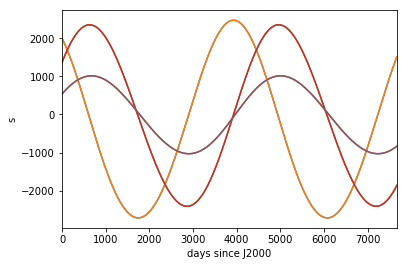

In [21]:
r = jupiter().helio_eq_coords(jdates,jupiter_fit)

for i in range(3):
    pp.plot(jdates - J2000, jupiter_ref[:,i])
    pp.plot(jdates - J2000, r[:,i])
    
pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.xlabel('days since J2000')
pp.ylabel('s')

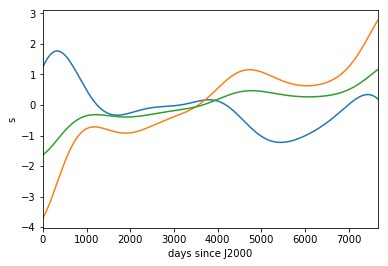

In [22]:
r = jupiter().helio_eq_coords(jdates,jupiter_fit)

for i in range(3):
    pp.plot(jdates - J2000, jupiter_ref[:,i] - r[:,i])
    
pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.xlabel('days since J2000')
pp.ylabel('s')

In [28]:
jupiter_elements = planet_partials(jupiter, jupiter_fit)

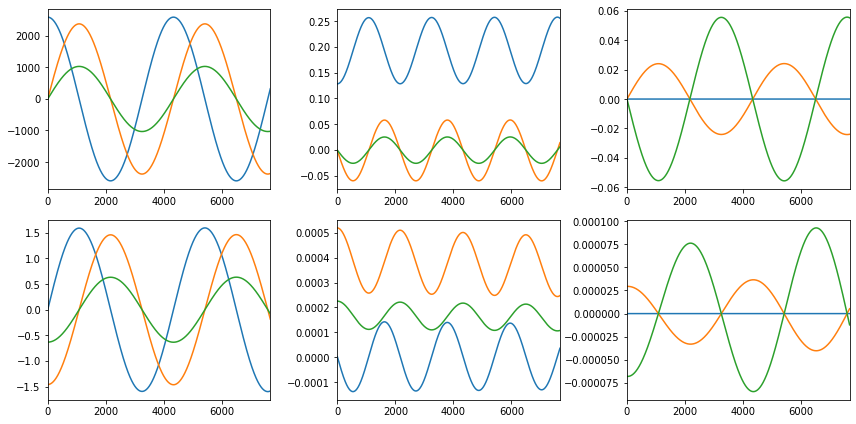

In [29]:
pp.figure(figsize=(12,6))

for j in range(6):
    pp.subplot(2,3,j+1)
    for i in range(3):
        pp.plot((jdates - J2000),jupiter_elements[j,:,i])
    pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.tight_layout()

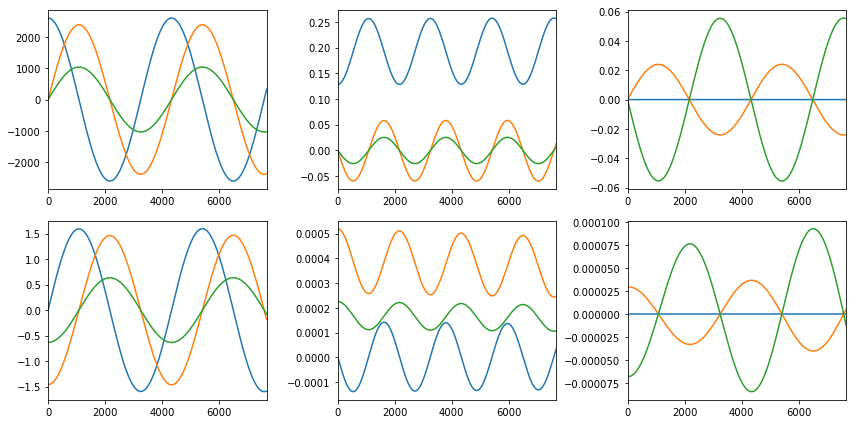

In [24]:
pp.figure(figsize=(12,6))

for j in range(6):
    pp.subplot(2,3,j+1)
    for i in range(3):
        pp.plot((jdates - J2000),jupiter_elements[j,:,i])
    pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.tight_layout()

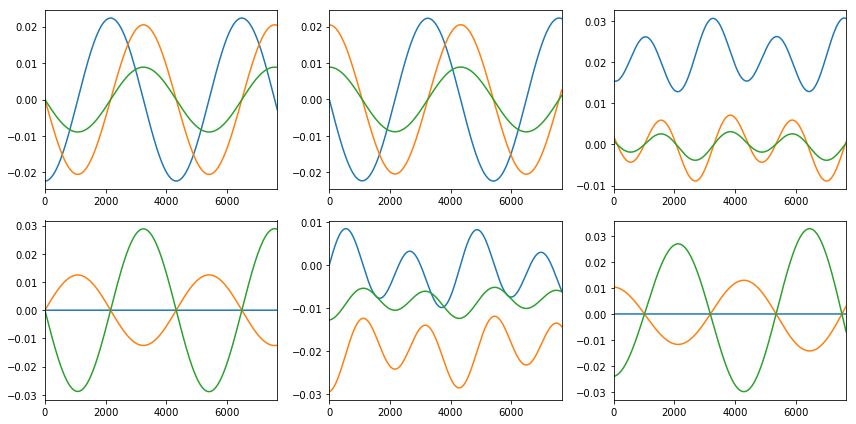

In [26]:
pp.figure(figsize=(12,6))

for j in range(6):
    pp.subplot(2,3,j+1)
    for i in range(3):
        pp.plot((jdates - J2000),jupiter_svd[j,:,i])
    pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.tight_layout()

In [21]:
saturn_fit = planet_fit(saturn_ref, saturn)

Optimization terminated successfully.
         Current function value: 2.254342
         Iterations: 552
         Function evaluations: 889
Optimization terminated successfully.
         Current function value: 2.254342
         Iterations: 198
         Function evaluations: 342
Optimization terminated successfully.
         Current function value: 2.254342
         Iterations: 201
         Function evaluations: 352
x = [ 0.00054832  0.00507519 -0.00013716  0.00124824 -0.00581609 -0.000614  ], res = 2.2543415357026837


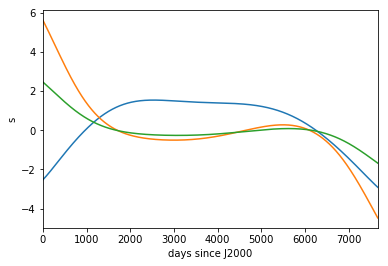

In [28]:
r = saturn().helio_eq_coords(jdates,saturn_fit)

for i in range(3):
    pp.plot(jdates - J2000, saturn_ref[:,i] - r[:,i])
    
pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.xlabel('days since J2000')
pp.ylabel('s')

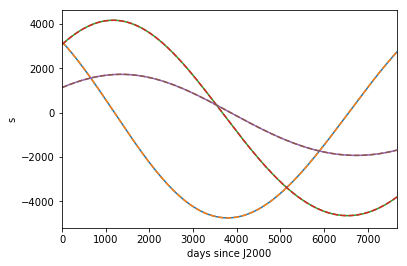

In [29]:
r = saturn().helio_eq_coords(jdates,saturn_fit)

for i in range(3):
    pp.plot(jdates - J2000, saturn_ref[:,i])
    pp.plot(jdates - J2000, r[:,i], '--')
    
pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.xlabel('days since J2000')
pp.ylabel('s')

In [22]:
saturn_elements = planet_partials(saturn, saturn_fit)

In [23]:
U, S, Vh = scipy.linalg.svd(saturn_elements.reshape((6,6000)),full_matrices=False)
saturn_svd = Vh.copy().reshape((6,2000,3))

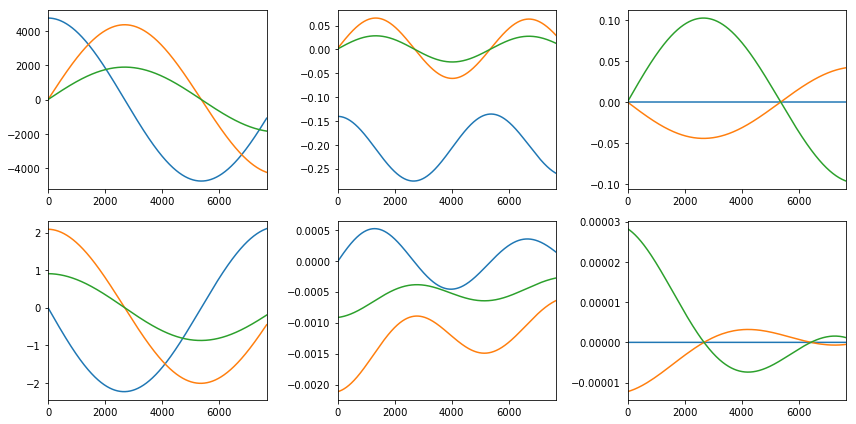

In [32]:
pp.figure(figsize=(12,6))

for j in range(6):
    pp.subplot(2,3,j+1)
    for i in range(3):
        pp.plot((jdates - J2000),saturn_elements[j,:,i])
    pp.axis(xmin=0, xmax=jdates[-1] - J2000)
pp.tight_layout()

Save files

In [33]:
# np.save('jupiter-elements.npy',jupiter_elements)
# np.save('jupiter-elements-svd.npy',jupiter_svd)

# np.save('saturn-elements.npy',saturn_elements)
# np.save('saturn-elements-svd.npy',saturn_svd)

    From http://maia.usno.navy.mil/NSFA/NSFA_cbe.html

    MS/MJ = 1.047348644e3 ± 1.7e-5
    MS/MSa = 3.4979018e3 ± 1e-4
    MS/MU = 2.2902951e4 ± 1.7e-2
    MS/MN = 1.941226e4 ± 3e-2

In [24]:
Msun_over_Mplanet = np.array([1.047348644e3,3.4979018e3,2.2902951e4,1.941226e4])
dMsun_over_Mplanet = np.array([1.7e-5,1e-4,1.7e-2,3e-2])

In [25]:
Mplanet_over_Msun = 1.0 / Msun_over_Mplanet
dMplanet_over_Msun = dMsun_over_Mplanet / Msun_over_Mplanet**2

In [36]:
dMplanet_over_Msun

array([  1.54976687e-11,   8.17306164e-12,   3.24090301e-11,
         7.96102625e-11])

In [37]:
table = [['Jupiter', 'Saturn', 'Uranus', 'Neptune'],
         map(lambda x: '{:.1e}'.format(x),dMplanet_over_Msun)]

display(HTML(tabulate.tabulate(table, tablefmt='html')))

Jupiter,Saturn,Uranus,Neptune
1.5e-11,8.2e-12,3.2e-11,8.0e-11


In [26]:
Mjup_over_Msun, Msat_over_Msun = Mplanet_over_Msun[0], Mplanet_over_Msun[1]

In [39]:
Mjup_over_Msun, Msat_over_Msun

(0.0009547918983127075, 0.00028588567008942334)

Change in Uranus, DE430 to 435

In [40]:
(5794548.6 - 5794556.4) / 132712440041.939400

-5.877369143601101e-11

Change in Neptune, DE421 to 430

In [41]:
(6836527.100580 - 6836535.) / 132712440041.939400

-5.952282994107456e-11

### Put everything together

In [27]:
def physical_model(x,earth,code):
    """Modify the fiducial `earth` orbit using parameters `x` and dates `mjd`
    for the model described by the string code. Specifically:
    
    - F to include a rotation of the frame (three Euler angles,
      plus angular rate for ecliptic z axis) and constant displacement offset;
    - f to include the frame rotation, but no offset;
    - J, S, U, N for Jupiter/Saturn/Uranus/Neptune mass perturbations;
    - j for the six Jupiter orbital elements.
    """
    
    i = 0
    
    # frame rotation
    if 'F' in code:
        earth = rotate(dates,earth,x[0],x[1],x[2],x[3],offset=x[4:7],equatorial=True)
        i = 7
    elif 'f' in code:
        earth = rotate(dates,earth,x[0],x[1],x[2],x[3],offset=None,equatorial=True)
        i = 4

    # Saturn mass
    if 'S' in code:
        earth = dmass(earth,saturn_ref,x[i])
        i += 1
    
    # Saturn elements
    if 's' in code:
        earth = earth + Msat_over_Msun * np.einsum('i,ijk->jk',np.array(x[i:i+6]),
                                                   saturn_svd if '+' in code else saturn_elements)
        i += 6
    
    # Uranus mass - uncertainty 3e-11, use twice that for prior (DE430-435 fit likes 6e-11)
    if 'U' in code:
        earth = dmass(earth,uranus_ref,x[i])
        i += 1

    # Neptune mass - uncertainty 8e-11, use twice that for prior (DE421-430 fit likes 6e-11 also)
    if 'N' in code:
        earth = dmass(earth,neptune_ref,x[i])
        i += 1
        
    # Jupiter mass
    if 'J' in code:
        earth = dmass(earth,jupiter_ref,x[i])
        i += 1

    # Jupiter elements (use all)
    if 'j' in code:
        earth = earth + Mjup_over_Msun * np.einsum('i,ijk->jk',np.array(x[i:i+6]),
                                                   jupiter_svd if '+' in code else jupiter_elements)
        i += 6
    
    assert i == len(x)
    
    return earth

In [28]:
def describe_model(x,code):    
    i = 0
    
    # frame rotation
    if 'F' in code:
        print("[{}:{}] - Frame: {}".format(0, 7, x[:7]))
        i = 7
    elif 'f' in code:
        print("[{}:{}] - Frame: {}".format(0, 4, x[:4]))
        i = 4

    # Saturn mass
    if 'S' in code:
        print("[{}] - Saturn mass: {}".format(i, x[i]))
        i += 1
    
    # Saturn elements
    if 's' in code:
        print("[{}:{}] - Saturn elements{}: {}".format(i, i+6, ' (svd)' if '+' in code else '', x[i:i+6]))
        i += 6
    
    # Uranus mass - uncertainty 3e-11, use twice that for prior (DE430-435 fit likes 6e-11)
    if 'U' in code:
        print("[{}] - Uranus mass: {}".format(i, x[i]))
        i += 1

    # Neptune mass - uncertainty 8e-11, use twice that for prior (DE421-430 fit likes 6e-11 also)
    if 'N' in code:
        print("[{}] - Neptune mass: {}".format(i, x[i]))
        i += 1
        
    # Jupiter mass
    if 'J' in code:
        print("[{}] - Jupiter mass: {}".format(i, x[i]))
        i += 1

    # Jupiter elements (use all)
    if 'j' in code:
        print("[{}:{}] - Jupiter elements{}: {}".format(i, i+6, ' (svd)' if '+' in code else '', x[i:i+6]))
        i += 6
    
    assert i == len(x)

In [29]:
def fitall(defit,deref,planet,code,disp=True,plot=True):
    efit = getplanet(defit,planet,jdates)
    eref = getplanet(deref,planet,jdates)
    
    def model(x):        
        return physical_model(x,efit,code)

    def minf(x):
        d = 1e9*(eref - model(x))
        return math.sqrt(np.sum(d**2) / d.shape[0])

    if code == '':
        d = 1e9*(eref - efit)
        return math.sqrt(np.sum(d**2) / d.shape[0])
    
    res = [0] * ((7 if 'F' in code else (4 if 'f' in code else 0)) +
                 ('S' in code) + 6 * ('s' in code) + ('U' in code) + ('N' in code) +
                 ('J' in code) + 6 * ('j' in code))
        
    for iter in range(4):
        res = so.fmin(minf,res,disp=disp)
    
    if disp:
        print('res = {}, x = {}'.format(minf(res),res))

    if plot:
        pp.figure(figsize=(8,2.5))

        pp.subplot(1,2,1)
        pp.plot((dates - dates[0])/365.25,1e9*(eref - efit),'--')
        pp.plot((dates - dates[0])/365.25,1e9*(eref - model(res)))

        pp.subplot(1,2,2)
        pp.plot((dates - dates[0])/365.25,1e9*(eref - model(res)))
    
    return minf(res), res

## Fits

Optimization terminated successfully.
         Current function value: 36.515755
         Iterations: 3208
         Function evaluations: 4251
Optimization terminated successfully.
         Current function value: 12.514584
         Iterations: 3619
         Function evaluations: 4538
res = 12.51458359039951, x = [ -2.87460633e-08  -3.78148699e-08   4.05828950e-09   4.93997859e-10
  -2.42711968e-07  -2.06395709e-07   6.65285900e-08   1.71293285e-11
   1.10065046e-02   5.91318642e-03  -1.74545685e-02   4.01165372e-03
   1.31661930e-03   1.95074272e-03  -4.60342432e-11   1.03328311e-13
   3.87171183e-11   3.22920011e-03  -2.12016399e-03   5.35963072e-04
   4.59513609e-03  -6.18570299e-03   7.46507418e-04]


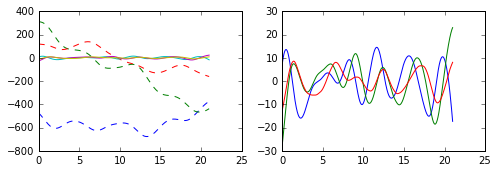

In [62]:
r, x = fitall('de430t.bsp','de436t.bsp',10,'FUNSJsj+')

In [109]:
describe_model(x, 'FUNSJsj+')

[0:7] - Frame: [ -2.87460633e-08  -3.78148699e-08   4.05828950e-09   4.93997859e-10
  -2.42711968e-07  -2.06395709e-07   6.65285900e-08]
[7] - Saturn mass: 1.712932852716956e-11
[8:14] - Saturn elements (svd): [ 0.0110065   0.00591319 -0.01745457  0.00401165  0.00131662  0.00195074]
[14] - Uranus mass: -4.6034243176539324e-11
[15] - Neptune mass: 1.0332831089543458e-13
[16] - Jupiter mass: 3.871711826796295e-11
[17:23] - Jupiter elements (svd): [ 0.0032292  -0.00212016  0.00053596  0.00459514 -0.0061857   0.00074651]


In [63]:
models = ['F', 'Fj', 'FUNj', 'FUNJj', 'FUNSj', 'FUNsj', 'FUNSJsj']
des = ['de418.bsp','de421.bsp','de430t.bsp','de435t.bsp']

In [68]:
if not os.path.isfile('sols.pickle'):
    sols = {}

    for de in des:
        for mod in models:
            sols[(de,mod)] = fitall(de,'de436t.bsp',10,mod,disp=False,plot=False)
            print(de,mod,sols[(de,mod)][0])

    pickle.dump(sols,open('sols.pickle','wb'))
else:
    sols = pickle.load(open('sols.pickle','rb'))

In [69]:
if not os.path.isfile('sols_earth.pickle'):
    sols_earth = {}

    for de in des:
        for mod in models:
            sols_earth[(de,mod)] = fitall(de,'de436t.bsp',3,mod,disp=False,plot=False)
            print(de,mod,sols[(de,mod)][0])

    pickle.dump(sols_earth,open('sols_earth.pickle','wb'))
else:
    sols_earth = pickle.load(open('sols_earth.pickle','rb'))

In [220]:
table = [[''] + models] + \
        [[de] + ['{:.1f}'.format(sols[(de,mod)][0]) for mod in models] for de in des]

display(HTML(tabulate.tabulate(table, tablefmt='html')))

,F,Fj,FUNj,FUNJj,FUNSj,FUNsj,FUNSJsj
de418.bsp,1377.5,1354.7,213.8,213.5,48.7,32.3,29.5
de421.bsp,172.8,122.3,25.1,25.1,58.2,24.1,25.2
de430t.bsp,240.2,229.9,15.2,15.2,47.8,16.9,13.9
de435t.bsp,24.6,5.2,3.2,2.9,3.1,1.9,1.9


In [226]:
table = [[''] + models] + \
        [[de] + ['{:.1f}'.format(sols_earth[(de,mod)][0]) for mod in models] for de in des]

display(HTML(tabulate.tabulate(table, tablefmt='html')))

,F,Fj,FUNj,FUNJj,FUNSj,FUNsj,FUNSJsj
de418.bsp,1477.7,1474.5,496.9,496.5,100.5,30.9,34.4
de421.bsp,199.1,188.5,54.3,53.6,51.3,32.8,50.8
de430t.bsp,245.6,222.4,18.7,18.1,18.7,17.1,13.8
de435t.bsp,58.9,11.0,10.0,9.6,5.2,4.3,4.4


## Check orbits from inference runs

### Definitions: Loading datafiles

In [8]:
!cat michele_epphysmodel_simAgwb0_chains/DE436/parameter_list.txt | grep frame_rate
!cat michele_epphysmodel_simAgwb0_chains/DE436/parameter_list.txt | grep dM
!cat michele_epphysmodel_simAgwb0_chains/DE436/parameter_list.txt | grep jupiter_orbel
!cat michele_epphysmodel_simAgwb0_chains/DE436/parameter_list.txt | grep saturn_orbel

73 frame_rate
74 jupiter_dM
75 saturn_dM
76 uranus_dM
77 neptune_dM
78 jupiter_orbel1
79 jupiter_orbel2
80 jupiter_orbel3
81 jupiter_orbel4
82 jupiter_orbel5
83 jupiter_orbel6
84 saturn_orbel1
85 saturn_orbel2
86 saturn_orbel3
87 saturn_orbel4
88 saturn_orbel5
89 saturn_orbel6


In [9]:
!cat michele_epphysmodel_noSatorb_simAgwb0_chains/DE436/parameter_list.txt | grep frame_rate
!cat michele_epphysmodel_noSatorb_simAgwb0_chains/DE436/parameter_list.txt | grep dM
!cat michele_epphysmodel_noSatorb_simAgwb0_chains/DE436/parameter_list.txt | grep jupiter_orbel
!cat michele_epphysmodel_noSatorb_simAgwb0_chains/DE436/parameter_list.txt | grep saturn_orbel

73 frame_rate
74 jupiter_dM
75 saturn_dM
76 uranus_dM
77 neptune_dM
78 jupiter_orbel1
79 jupiter_orbel2
80 jupiter_orbel3
81 jupiter_orbel4
82 jupiter_orbel5
83 jupiter_orbel6


In [707]:
!cat michele_epphysmodel_nosat_nano11yr_chains/DE436/parameter_list.txt | grep frame_rate
!cat michele_epphysmodel_nosat_nano11yr_chains/DE436/parameter_list.txt | grep dM
!cat michele_epphysmodel_nosat_nano11yr_chains/DE436/parameter_list.txt | grep jupiter_orbel
!cat michele_epphysmodel_nosat_nano11yr_chains/DE436/parameter_list.txt | grep saturn_orbel

69 frame_rate
70 jupiter_dM
71 saturn_dM
72 uranus_dM
73 neptune_dM
74 jupiter_orbel1
75 jupiter_orbel2
76 jupiter_orbel3
77 jupiter_orbel4
78 jupiter_orbel5
79 jupiter_orbel6


In [30]:
def loadpars(datadir='michele_epphysmodel_simAgwb0_chains', eph='DE435', savefile=None,
             zerosaturn=False):
    chain = np.loadtxt('{}/{}/chain_1.txt'.format(datadir,eph))
    
    if datadir == 'michele_epphysmodel_simAgwb0_chains':
        pars = chain[:,73:90]
    elif datadir == 'michele_epphysmodel_nano11yr_chains':
        pars = chain[:,69:86]
    elif datadir == 'michele_epphysmodel_noSatorb_simAgwb0_chains':
        pars = chain[:,73:84]
    elif datadir == 'michele_epphysmodel_nosat_nano11yr_chains':
        pars = chain[:,69:80]
    
    if savefile: 
        np.save('{}/{}.npy'.format(datadir,eph))
    
    if zerosaturn:
        pars[:,-6:] = 0.0
    
    return pars

### Definitions: Perturbed orbits + frame-rotation fit

In [31]:
def perturb(p, efit, disp=True):
    if len(p) == 17:   
        x = np.array([0, 0, 0] + [p[0]] + [0, 0, 0] + [p[2]] + list(p[11:17]) + [p[3],p[4],p[1]] + list(p[5:11]))
        code = 'FSUNJjs+'
    elif len(p) == 11:
        x = np.array([0, 0, 0] + [p[0]] + [0, 0, 0] + [p[2]] + [p[3],p[4],p[1]] + list(p[5:11]))
        code = 'FSUNJj+'
    else:
        raise NotImplementedError
        
    if disp:
        describe_model(x,code)
    
    return physical_model(x, efit, code)

In [32]:
def perturbfit(p, efit, eref, disp=True):
    def model(x):
        if len(p) == 17:
            x = np.array(list(x[:3]) + [p[0]] + list(x[3:6]) + [p[2]] + list(p[11:17]) + [p[3],p[4],p[1]] + list(p[5:11]))        
            return physical_model(x, efit, 'FSUNJjs+')
        elif len(p) == 11:
            x = np.array(list(x[:3]) + [p[0]] + list(x[3:6]) + [p[2]] + [p[3],p[4],p[1]] + list(p[5:11]))        
            return physical_model(x, efit, 'FSUNJj+')
        else:
            raise NotImplementedError
            
    def minf(x):
        d = 1e9*(eref - model(x))
        return math.sqrt(np.sum(d**2) / d.shape[0])
    
    res = [0] * 6
    
    for iter in range(4):
        res = so.fmin(minf,res,disp=disp)
    
    if disp:
        print('res = {}, x = {}'.format(minf(res),res))

    return minf(res), res, model(res)

In [33]:
class linearfit(object):
    def model(self, x, p):
        if len(p) == 17:
            x = np.array(list(x[:3]) + [p[0]] + list(x[3:6]) + [p[2]] + list(p[11:17]) + [p[3],p[4],p[1]] + list(p[5:11]))        
            return physical_model(x, self.efit, 'FSUNJjs+')
        elif len(p) == 11:
            x = np.array(list(x[:3]) + [p[0]] + list(x[3:6]) + [p[2]] + [p[3],p[4],p[1]] + list(p[5:11]))        
            return physical_model(x, self.efit, 'FSUNJj+')        
        
    def __init__(self, efit, eref, dx=1e-6):
        self.efit, self.eref = efit, eref
        
        self.Amat = np.zeros((len(dates),3,6),'d')
        
        p = [0] * 17
        zero = self.model(np.zeros(6,'d'), p)
        for i in range(6):
            disp = np.zeros(6,'d'); disp[i] = dx

            self.Amat[:,:,i] = (self.model(disp, p) - self.model(-disp, p)) / (2*dx)
        
        self.Amat = self.Amat.reshape((6000,6))
        
    def fit(self, p):
        b = (self.model([0,0,0,0,0,0], p) - self.eref).reshape((6000,))
        
        s = np.linalg.lstsq(self.Amat, b)
        
        return self.eref + (b - np.dot(self.Amat, s[0])).reshape((2000,3))

Check

In [114]:
pars = loadpars(datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',eph='DE430')
efit = getplanet('de430t.bsp',10,jdates)
eref = getplanet('de435t.bsp',10,jdates)

In [115]:
f = linearfit(efit, eref)

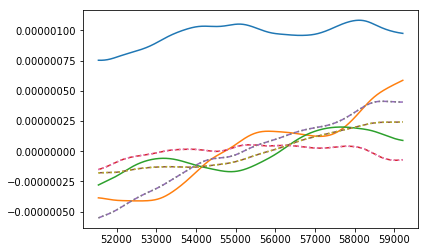

In [116]:
pp.plot(dates, f.model([0,0,0,0,0,0], pars[10000,:]) - eref)
pp.plot(dates, f.fit(pars[10000,:]) - eref, '--')
pp.plot(dates, perturbfit(pars[10000,:], efit, eref, disp=False)[2] - eref, ':')

### Definitions: Plotting

Note 1 us = 300 m.

In [34]:
def plotorbits(efit, eref, orbmean, orbm, orbp, ymax, best=None):
    pp.figure(figsize=(9,2))

    for i in range(3):
        pp.subplot(1,3,i+1)

        d = efit[:,i] - eref[:,i]
        pp.plot(dates/1000, 1e9*d, '--')

        # for orb in orbs:
        #     d = orb[:,i] - eref[:,i]
        #     pp.plot(dates/1000, 1e9*d, 'k', alpha = 0.1)

        d05 = orbm[:,i] - eref[:,i]
        d95 = orbp[:,i] - eref[:,i]
        pp.fill_between(dates/1000,1e9*d05,1e9*d95,
                        color='b',alpha=0.25)

        d = orbmean[:,i] - eref[:,i]
        pp.plot(dates/1000, 1e9*d, 'r')

        if best is not None:
            db = best[:,i] - eref[:,i]
            pp.plot(dates/1000, 1e9*db, 'g:')
        
        pp.axis(ymin=-ymax,ymax=ymax)
        pp.xlabel('MJD/1000')
        pp.ylabel('ns')
        
        pp.tight_layout(rect=[0, 0.03, 1, 0.95])

        pp.suptitle('Orbits')

In [35]:
def plotsphorbits(efit, eref, orbmean, orbm, orbp, ymax, best=None):
    pp.figure(figsize=(9,2))

    for i in range(3):
        pp.subplot(1,3,i+1)

        ef, er = xyz2sph(efit[:,:]), xyz2sph(eref[:,:])
        
        if i == 0:
            pp.plot(dates/1000, 1e9*(ef[:,0] - er[:,0]), '--')
        else:
            pp.plot(dates/1000, 1e9*ef[:,0]*(ef[:,i] - er[:,i]), '--')
            
        # for orb in orbs:
        #     d = orb[:,i] - eref[:,i]
        #     pp.plot(dates/1000, 1e9*d, 'k', alpha = 0.1)

        ef05, er05 = xyz2sph(orbm[:,:]), xyz2sph(eref[:,:])
        ef95, er95 = xyz2sph(orbp[:,:]), xyz2sph(eref[:,:])

        if i == 0:            
            pp.fill_between(dates/1000,
                            1e9*(ef05[:,0] - er05[:,0]),
                            1e9*(ef95[:,0] - er95[:,0]),
                            color='b',alpha=0.25)
        else:
            pp.fill_between(dates/1000,
                            1e9*ef05[:,0]*(ef05[:,i] - er05[:,i]),
                            1e9*ef95[:,0]*(ef95[:,i] - er95[:,i]),
                            color='b',alpha=0.25)
            
            
        ef, er = xyz2sph(orbmean[:,:]), xyz2sph(eref[:,:])
        
        if i == 0:
            pp.plot(dates/1000, 1e9*(ef[:,0] - er[:,0]), 'r')
        else:
            pp.plot(dates/1000, 1e9*ef[:,0]*(ef[:,i] - er[:,i]), 'r')

        if best is not None:
            ef, er = xyz2sph(best[:,:]), xyz2sph(eref[:,:])

            if i == 0:
                pp.plot(dates/1000, 1e9*(ef[:,0] - er[:,0]), 'g:')
            else:
                pp.plot(dates/1000, 1e9*ef[:,0]*(ef[:,i] - er[:,i]), 'g:')
        
        pp.axis(ymin=-ymax,ymax=ymax)
        pp.xlabel('MJD/1000')
        pp.ylabel(['dR','RdRA','RdDEC'][i] + ' ns')
        
        pp.tight_layout(rect=[0, 0.03, 1, 0.95])

        pp.suptitle('Orbits')

Roemers

In [36]:
psrpos = pickle.load(open('truepsrpos.pickle','rb'))

In [52]:
psrpos

{'J1600-3053': array([-0.42623768, -0.74476316, -0.51346789]),
 'J1640+2224': array([-0.31514963, -0.86914314,  0.38114421]),
 'J1713+0747': array([-0.19826534, -0.97071683,  0.13564549]),
 'J1909-3744': array([ 0.23711654, -0.75446412, -0.61201278]),
 'J2317+1439': array([ 0.95059314, -0.17980437,  0.25306731])}

In [37]:
def plotroemers(efit, eref, orbmean, orbm, orbp, ymax, best=None):
    pp.figure(figsize=(9,4))

    for i in range(5):
        pp.subplot(2,3,i+1)

        pos = list(psrpos.values())[i]

        d = np.dot(efit[:,:] - eref[:,:], pos)
        pp.plot(dates/1000, 1e9*d, '--')

        # for orb in orbs:
        #     d = np.dot(orb[:,:] - eref[:,:], pos)
        #     pp.plot(dates/1000, 1e9*d, 'k', alpha = 0.1)

        dm = np.dot(orbm[:,:] - eref[:,:], pos)
        dp = np.dot(orbp[:,:] - eref[:,:], pos)

        pp.fill_between(dates/1000, 1e9*dm, 1e9*dp,
                        color='b', alpha=0.25)

        d = np.dot(orbmean[:,:] - eref[:,:], pos)
        pp.plot(dates/1000, 1e9*d, 'r')

        if best is not None:
            db = np.dot(best[:,:] - eref[:,:], pos)
            pp.plot(dates/1000, 1e9*db, 'g:')
        
        pp.axis(ymin=-ymax,ymax=ymax)
        pp.xlabel('MJD/1000')
        pp.ylabel('ns')
        
        pp.tight_layout(rect=[0, 0.03, 1, 0.95])
                
        pp.suptitle('Roemer delays (J1600, J1640, J1713, J1909, J2317)')

Roemers minus 2nd-order polynomial fit

In [38]:
def project(dates, diff):
    x = (dates - dates[0]) / (dates[-1] - dates[0])
    y = diff
    
    a = np.polyfit(x, y, 2)
    p = np.poly1d(a)
    
    return y - p(x)

In [39]:
def plotprojected(efit,eref,orbmean,pmorbs,pporbs,ymax,best=None):
    pp.figure(figsize=(9,4))

    for i in range(5):
        pp.subplot(2,3,i+1)

        pos = list(psrpos.values())[i]

        d = np.dot(efit[:,:] - eref[:,:], pos)
        pp.plot(dates/1000, 1e9*project(dates, d), '--')

        # for orb in orbs:
        #     d = np.dot(orb[:,:] - eref[:,:], pos)
        #     pp.plot(dates/1000, 1e9*project(dates, d), 'k', alpha = 0.1)

        # dm = np.dot(orbm[:,:] - eref[:,:], pos)
        # dp = np.dot(orbp[:,:] - eref[:,:], pos)

        pp.fill_between(dates/1000, 1e9*pmorbs[i], 1e9*pporbs[i],
                        color='b', alpha=0.25)

        d = np.dot(orbmean[:,:] - eref[:,:], pos)
        pp.plot(dates/1000, 1e9*project(dates, d), 'r')

        if best is not None:
            db = np.dot(best[:,:] - eref[:,:], pos)
            pp.plot(dates/1000, 1e9*project(dates, db), 'g:')
        
        pp.axis(ymin=-ymax,ymax=ymax)
        pp.xlabel('MJD/1000')
        pp.ylabel('ns')
        
        pp.tight_layout(rect=[0, 0.03, 1, 0.95])
        
        pp.suptitle('Projected Roemer delays')

In [40]:
def analyze(defit, deref, datadir='michele_epphysmodel_simAgwb0_chains',
            zerosaturn = False, suffix = '', ymax = None):
    if ymax is None:
        if zerosaturn:
            ymax = [1000, 1000, 1000]
        else:
            ymax = [4000, 4000, 1500]
    else:
        if not isinstance(ymax,(list,tuple)):
            ymax = [ymax] * 3
    
    ephname = defit[:5].upper()
    
    efit = getplanet(defit,10,jdates)
    eref = getplanet(deref,10,jdates)
    
    print("Loading...")
    pars = loadpars(datadir=datadir, eph=ephname, zerosaturn=zerosaturn)

    print("Fitting...")
    code = 'FUNSJj+' if pars.shape[1] == 1 else 'FUNSJjs+'
    r, x = fitall(defit, deref, 10, code, disp=False, plot=False)
    y = physical_model(x, efit, code)
    
    f = linearfit(efit, eref)

    print("Refitting...")
    orbs = [f.fit(pars[np.random.randint(pars.shape[0]),:]) for i in range(100)]

    print("Percentiles...")
    orbmean = np.mean(np.array(orbs),axis=0)
    orbm = np.percentile(np.array(orbs),16,axis=0)
    orbp = np.percentile(np.array(orbs),84,axis=0)
    
    print("Plotting...")
    plotsphorbits(efit, eref, orbmean, orbm, orbp, ymax[0], best=y)
    
    opng = ephname + '-orbits-' + datadir + '.png'
    pp.savefig(opng)
    
    plotroemers(efit, eref, orbmean, orbm, orbp, ymax[1], best=y)
    
    rpng = ephname + '-roemers-' + datadir + '.png'
    pp.savefig(rpng)

    print("Projecting...")
    
    porbs, pmorbs, pporbs = {}, {}, {}

    for i in range(5):
        pos = list(psrpos.values())[i]

        porbs[i] = [project(dates,np.dot(orb - eref,pos)) for orb in orbs]

        pmorbs[i] = np.percentile(np.array(porbs[i]),16,axis=0)
        pporbs[i] = np.percentile(np.array(porbs[i]),84,axis=0)
        
    plotprojected(efit,eref,orbmean,pmorbs,pporbs, ymax[2], best=y)

    ppng = ephname + '-projected-' + datadir + '.png'
    pp.savefig(ppng)
    
    filename = ephname + suffix + '-' + datadir + ".pdf"
    
    print("Done! Saving to {}.".format(filename))
    
    c = canvas.Canvas(filename)
    c.drawString(275,810,ephname)
    c.drawInlineImage(opng,0,650,width=600)
    c.drawInlineImage(rpng,0,350,width=600)
    c.drawInlineImage(ppng,0,50,width=600)
    c.showPage()
    c.save()

In [59]:
def analyzebin(defit, deref, binfile, datadir, suffix = '', ymax = None):
    if ymax is None:
        ymax = [4000, 4000, 1500]
    else:
        if not isinstance(ymax,(list,tuple)):
            ymax = [ymax] * 3
    
    ephname = defit[:5].upper()
    
    efit = getplanet(defit,10,jdates)
    eref = getplanet(deref,10,jdates)
    
    print("Loading...")

    chain = np.load(binfile)['chain']
    
    # would be 70:81 with gamvary
    if 'vgamma' in binfile:
        pars = chain[::10,70:81]
    else:
        pars = chain[::10,69:80]

    print("Fitting...")
    code = 'FUNSJj+'
    r, x = fitall(defit, deref, 10, code, disp=False, plot=False)
    y = physical_model(x, efit, code)
    
    f = linearfit(efit, eref)

    print("Refitting...")
    orbs = [f.fit(pars[np.random.randint(pars.shape[0]),:]) for i in range(100)]

    print("Percentiles...")
    orbmean = np.mean(np.array(orbs),axis=0)
    orbm = np.percentile(np.array(orbs),16,axis=0)
    orbp = np.percentile(np.array(orbs),84,axis=0)
    
    print("Plotting...")
    plotsphorbits(efit, eref, orbmean, orbm, orbp, ymax[0], best=y)
    
    opng = ephname + '-orbits-' + datadir + '.png'
    pp.savefig(opng)
    
    plotroemers(efit, eref, orbmean, orbm, orbp, ymax[1], best=y)
    
    rpng = ephname + '-roemers-' + datadir + '.png'
    pp.savefig(rpng)

    print("Projecting...")
    
    porbs, pmorbs, pporbs = {}, {}, {}

    for i in range(5):
        pos = list(psrpos.values())[i]
        
        porbs[i] = [project(dates,np.dot(orb - eref,pos)) for orb in orbs]

        pmorbs[i] = np.percentile(np.array(porbs[i]),16,axis=0)
        pporbs[i] = np.percentile(np.array(porbs[i]),84,axis=0)
        
    plotprojected(efit,eref,orbmean,pmorbs,pporbs, ymax[2], best=y)

    ppng = ephname + '-projected-' + datadir + '.png'
    pp.savefig(ppng)
    
    filename = ephname + suffix + '-' + datadir + ".pdf"
    
    print("Done! Saving to {}.".format(filename))
    
    c = canvas.Canvas(filename)
    c.drawString(275,810,ephname)
    c.drawInlineImage(opng,0,650,width=600)
    c.drawInlineImage(rpng,0,350,width=600)
    c.drawInlineImage(ppng,0,50,width=600)
    c.showPage()
    c.save()

In [61]:
psrpos

{'J1600-3053': array([-0.42623768, -0.74476316, -0.51346789]),
 'J1640+2224': array([-0.31514963, -0.86914314,  0.38114421]),
 'J1713+0747': array([-0.19826534, -0.97071683,  0.13564549]),
 'J1909-3744': array([ 0.23711654, -0.75446412, -0.61201278]),
 'J2317+1439': array([ 0.95059314, -0.17980437,  0.25306731])}

### 11yr runs

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE436-nano11-log-openprior-de436.pdf.


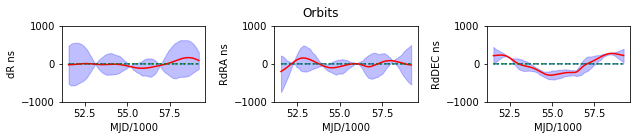

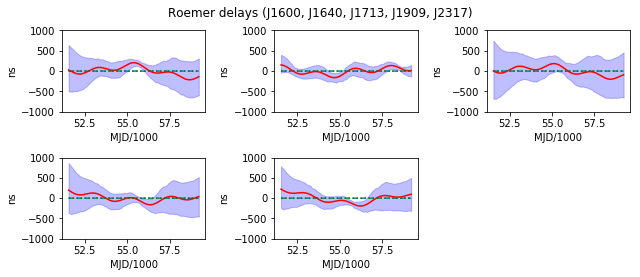

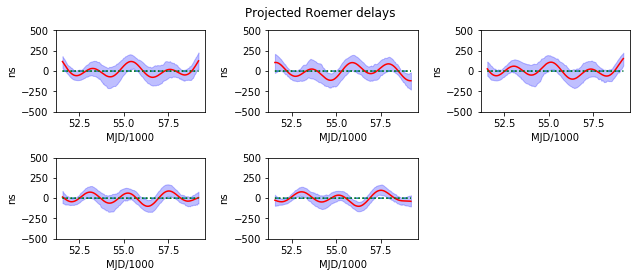

In [62]:
analyzebin('de436t.bsp','de436t.bsp','newchains/nano11-log-openprior-de436.npz','nano11-log-openprior-de436',
           ymax=[1000,1000,500])

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE436-nano11-vgamma-log-openprior-de436.pdf.


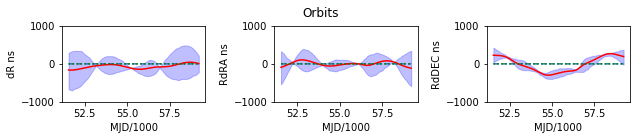

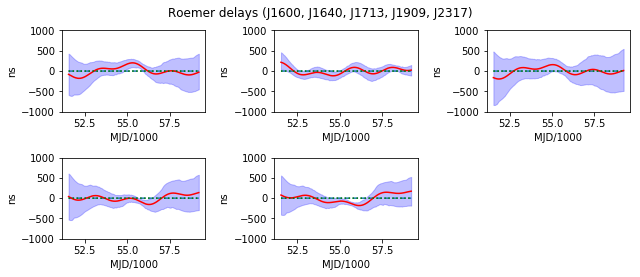

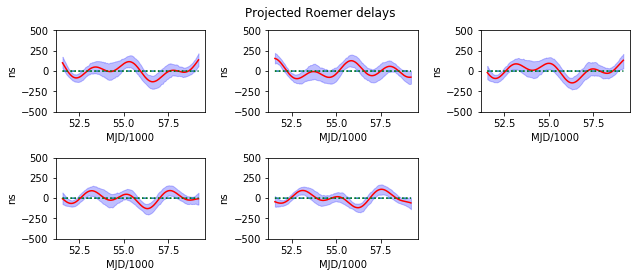

In [63]:
analyzebin('de436t.bsp','de436t.bsp','newchains/nano11-vgamma-log-openprior-de436.npz',
           'nano11-vgamma-log-openprior-de436',
           ymax=[1000,1000,500])

### MDC simulations, Jupiter + Saturn elements

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


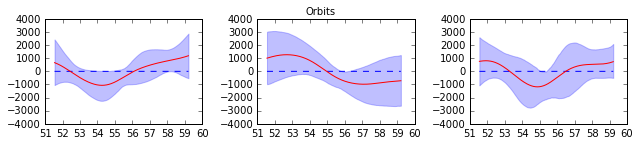

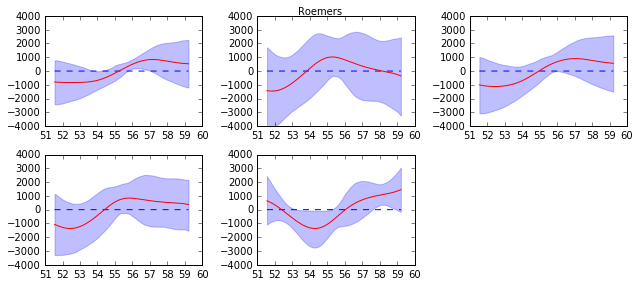

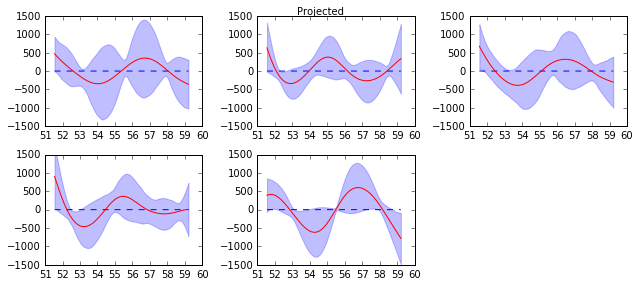

In [82]:
analyze('de436t.bsp','de436t.bsp')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


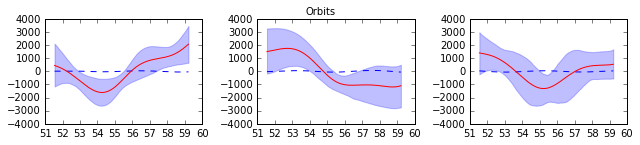

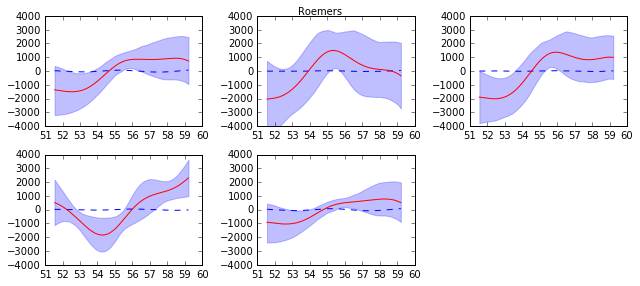

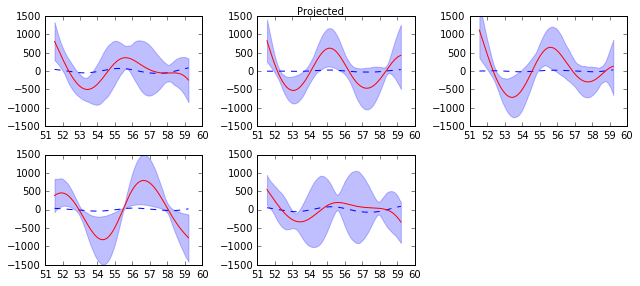

In [569]:
analyze('de435t.bsp','de436t.bsp')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


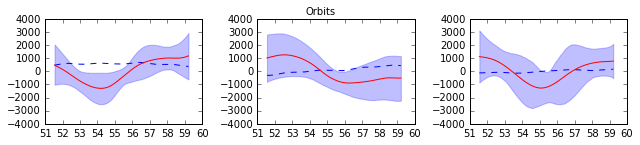

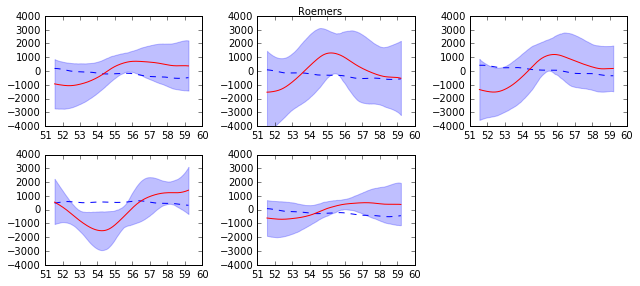

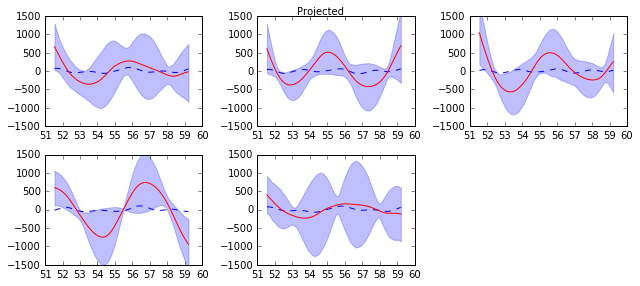

In [570]:
analyze('de430t.bsp','de436t.bsp')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


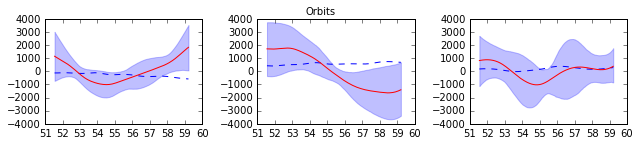

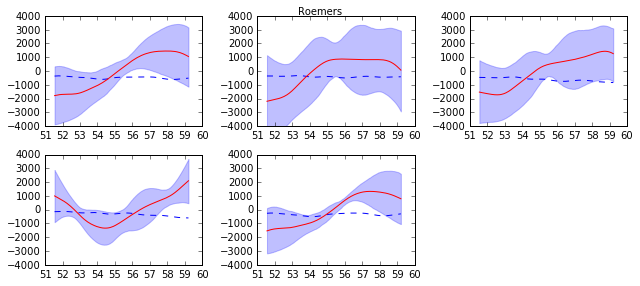

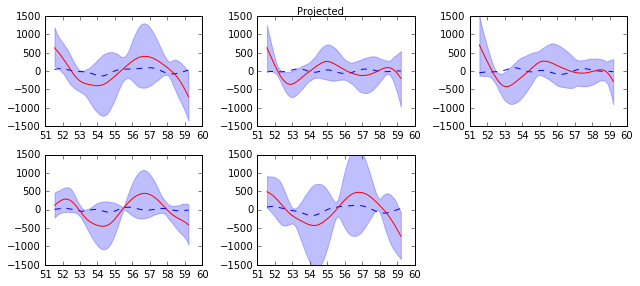

In [571]:
analyze('de421.bsp','de436t.bsp')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


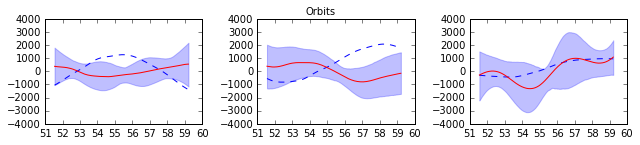

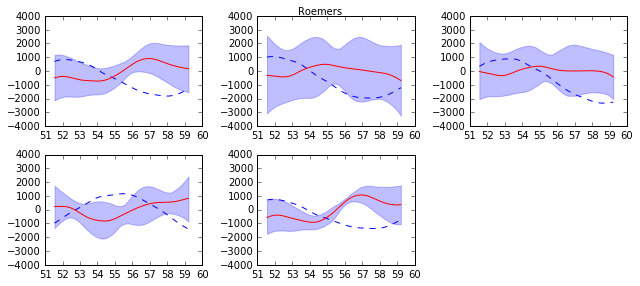

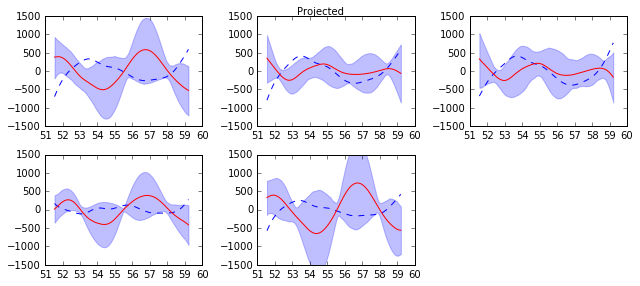

In [572]:
analyze('de418.bsp','de436t.bsp')

### 11yr, Jupiter elements only

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE436-nosat11yr-michele_epphysmodel_nosat_nano11yr_chains.pdf.


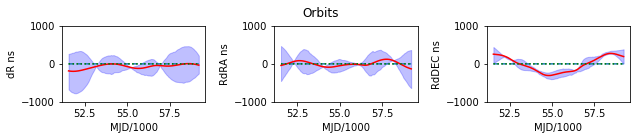

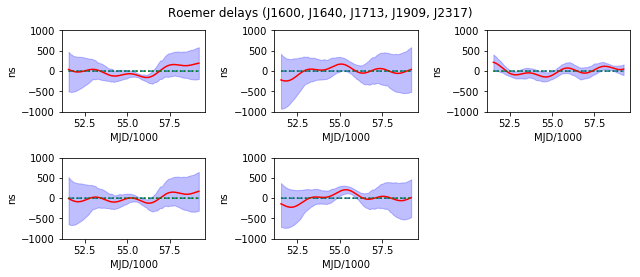

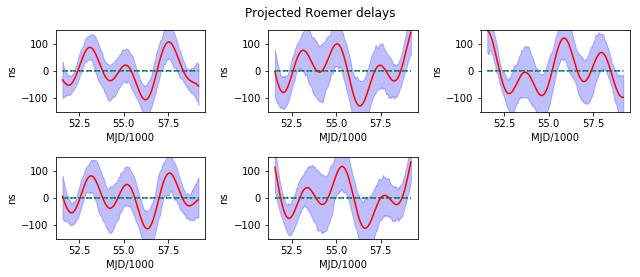

In [749]:
analyze('de436t.bsp','de436t.bsp',datadir='michele_epphysmodel_nosat_nano11yr_chains',
        ymax=[1000,1000,150],suffix='-nosat11yr')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE435-nosat11yr-michele_epphysmodel_nosat_nano11yr_chains.pdf.


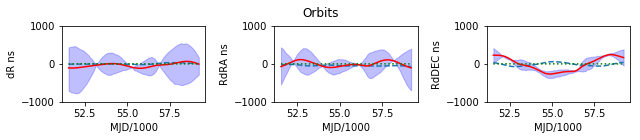

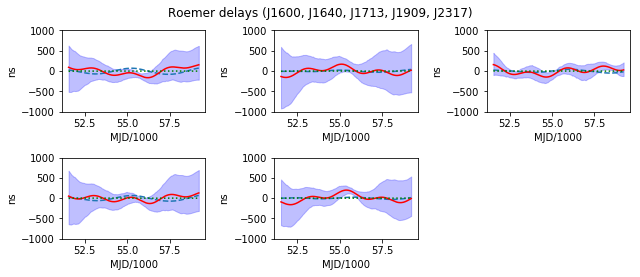

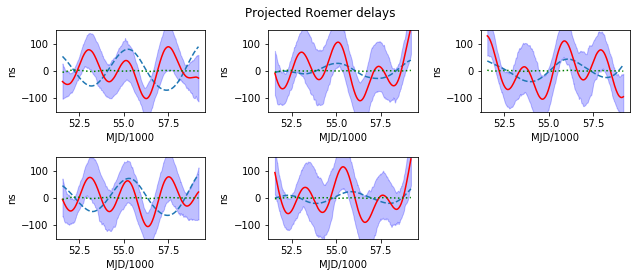

In [750]:
analyze('de435t.bsp','de436t.bsp',datadir='michele_epphysmodel_nosat_nano11yr_chains',
        ymax=[1000,1000,150],suffix='-nosat11yr')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE430-nosat11yr-michele_epphysmodel_nosat_nano11yr_chains.pdf.


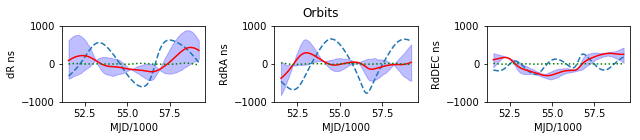

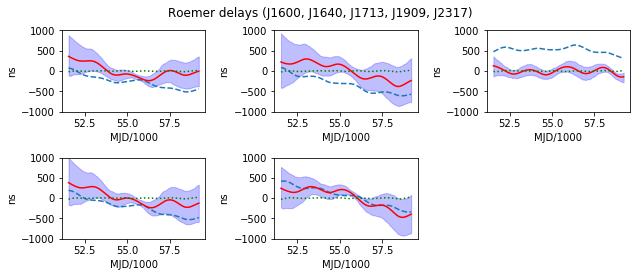

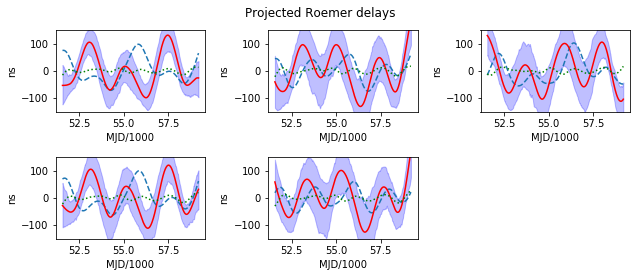

In [751]:
analyze('de430t.bsp','de436t.bsp',datadir='michele_epphysmodel_nosat_nano11yr_chains',
        ymax=[1000,1000,150],suffix='-nosat11yr')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE421-nosat11yr-michele_epphysmodel_nosat_nano11yr_chains.pdf.


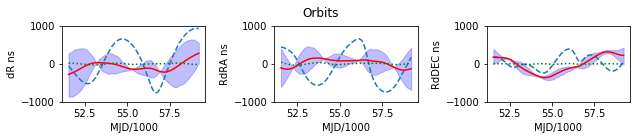

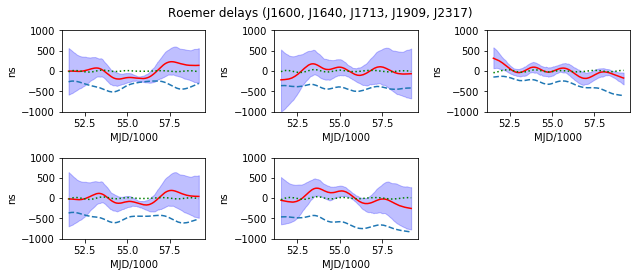

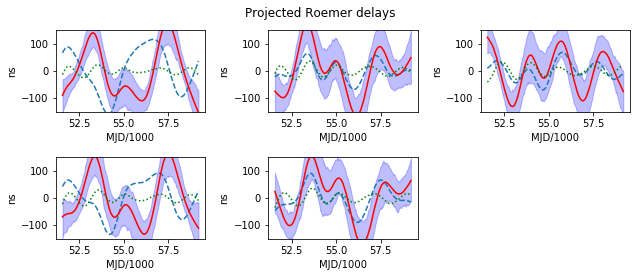

In [752]:
analyze('de421.bsp','de436t.bsp',datadir='michele_epphysmodel_nosat_nano11yr_chains',
        ymax=[1000,1000,150],suffix='-nosat11yr')

### MDC simulations, Jupiter elements only

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE436-nosat-michele_epphysmodel_noSatorb_simAgwb0_chains.pdf.


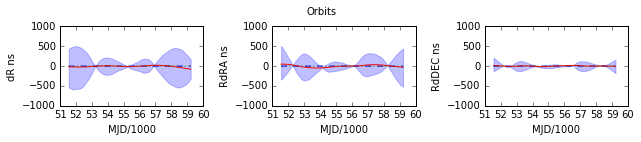

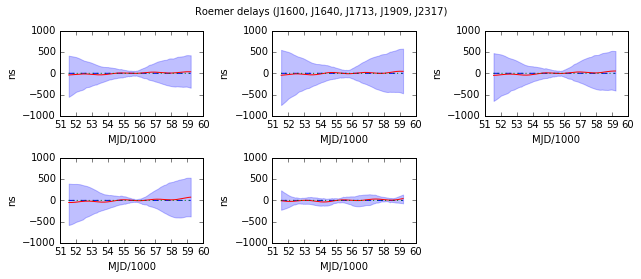

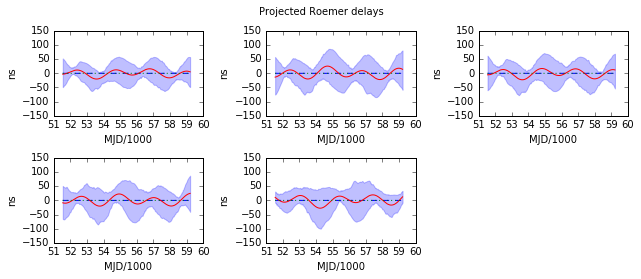

In [152]:
analyze('de436t.bsp','de436t.bsp',datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',
        ymax=[1000,1000,150],suffix='-nosat')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE435-nosat-michele_epphysmodel_noSatorb_simAgwb0_chains.pdf.


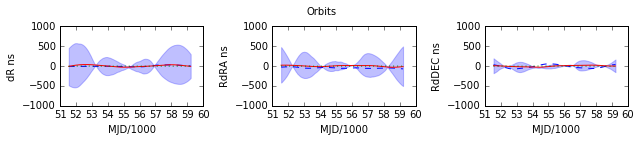

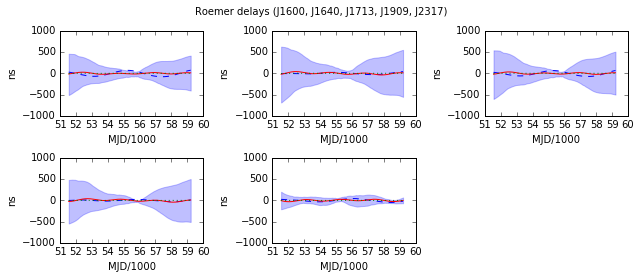

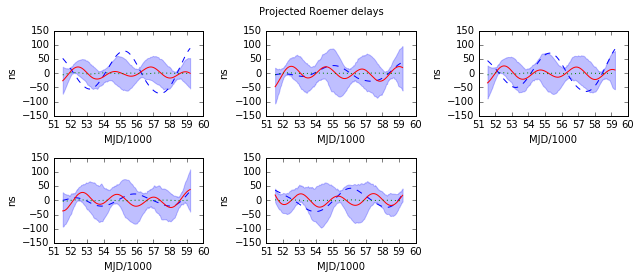

In [153]:
analyze('de435t.bsp','de436t.bsp',datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',
        ymax=[1000,1000,150],suffix='-nosat')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE430-nosat-michele_epphysmodel_noSatorb_simAgwb0_chains.pdf.


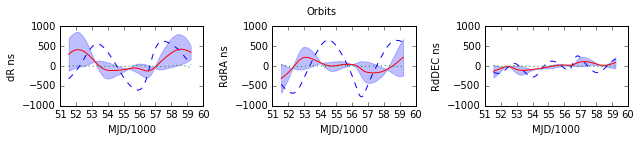

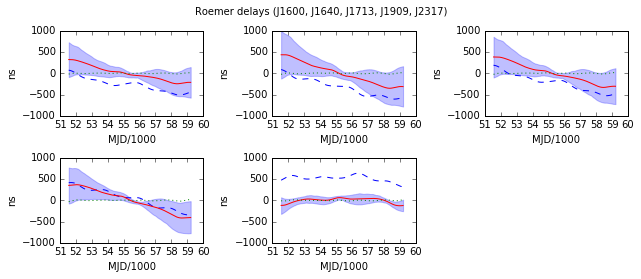

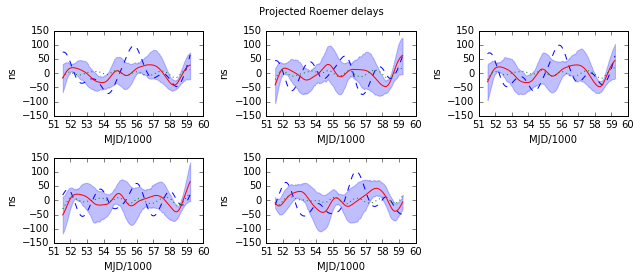

In [154]:
analyze('de430t.bsp','de436t.bsp',datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',
        ymax=[1000,1000,150],suffix='-nosat')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE421-nosat-michele_epphysmodel_noSatorb_simAgwb0_chains.pdf.


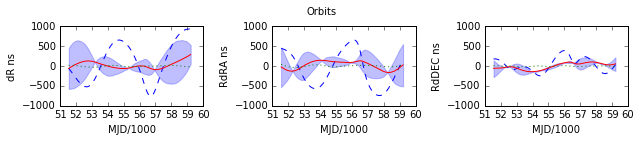

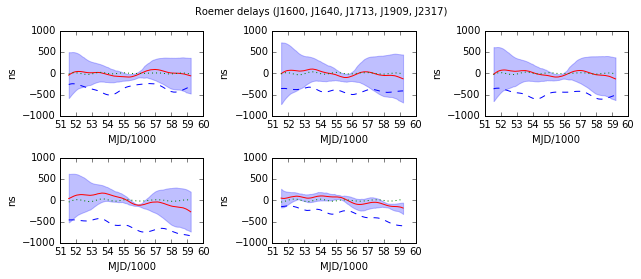

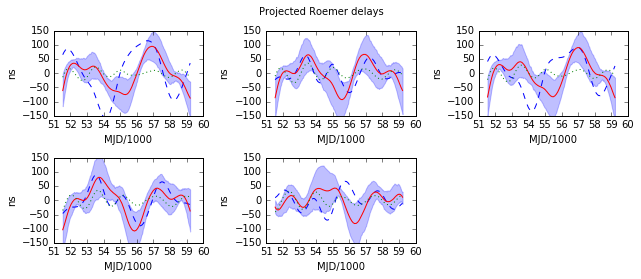

In [155]:
analyze('de421.bsp','de436t.bsp',datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',
        ymax=[1000,1000,150],suffix='-nosat')

Loading...
Fitting...
Refitting...
Percentiles...
Plotting...
Projecting...
Done! Saving to DE418-nosat-michele_epphysmodel_noSatorb_simAgwb0_chains.pdf.


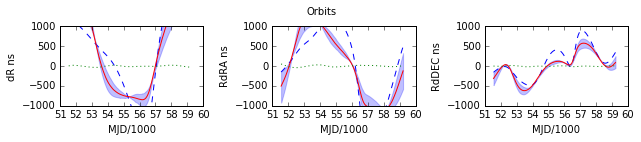

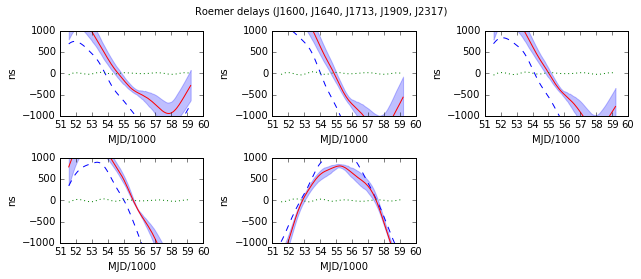

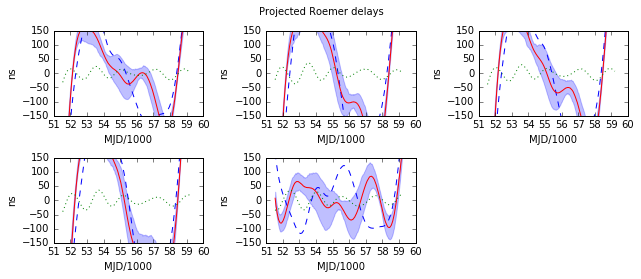

In [156]:
analyze('de418.bsp','de436t.bsp',datadir='michele_epphysmodel_noSatorb_simAgwb0_chains',
        ymax=[1000,1000,150],suffix='-nosat')

### 11-yr dataset, Jupiter + Saturn elements

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


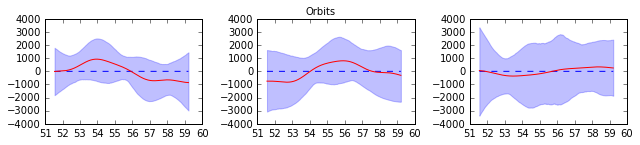

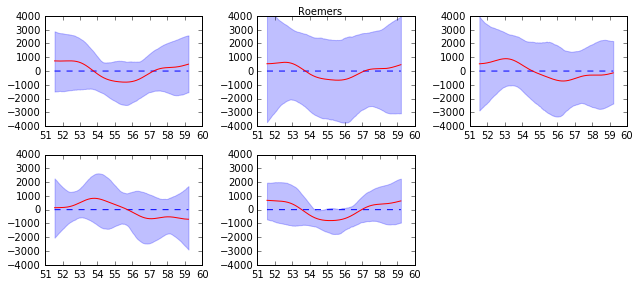

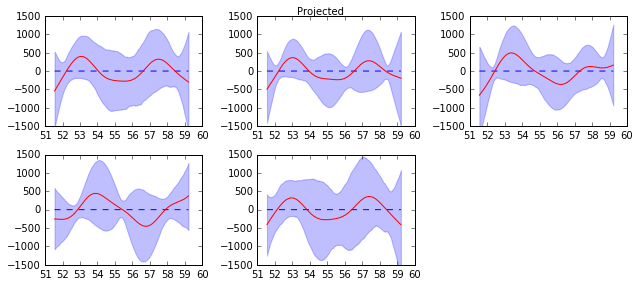

In [573]:
analyze('de436t.bsp','de436t.bsp',datadir='michele_epphysmodel_nano11yr_chains')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


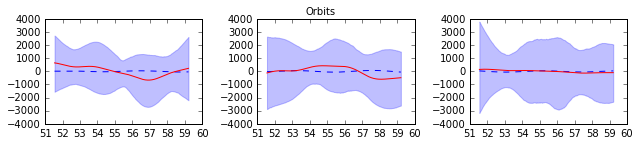

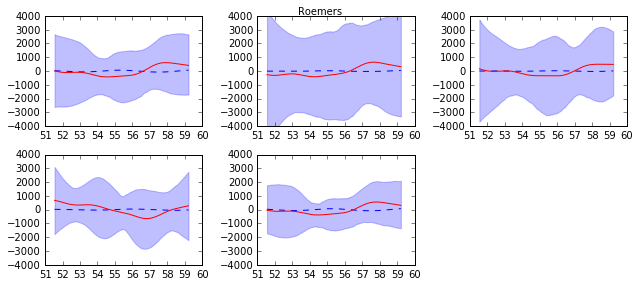

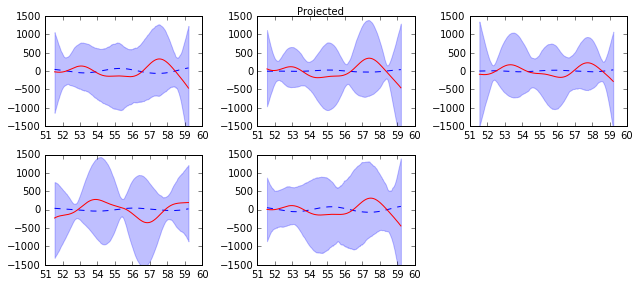

In [574]:
analyze('de435t.bsp','de436t.bsp',datadir='michele_epphysmodel_nano11yr_chains')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


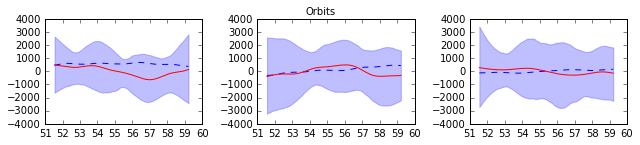

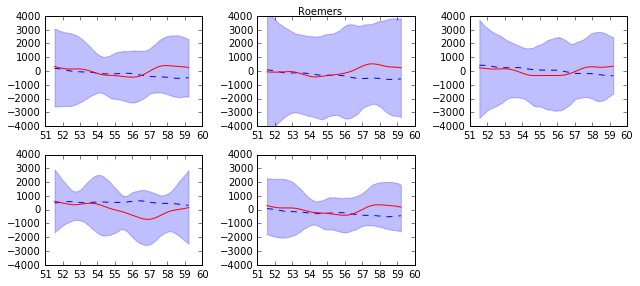

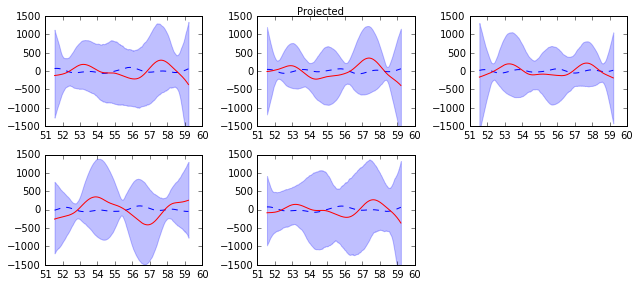

In [575]:
analyze('de430t.bsp','de436t.bsp',datadir='michele_epphysmodel_nano11yr_chains')

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


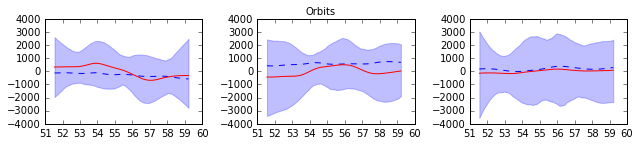

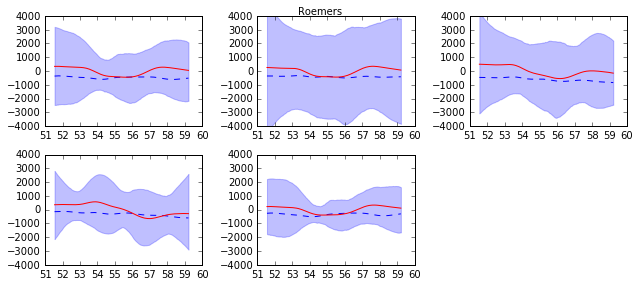

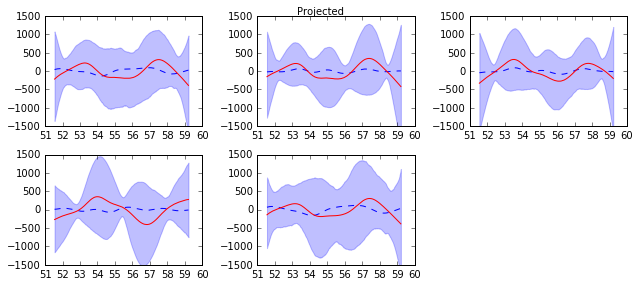

In [576]:
analyze('de421.bsp','de436t.bsp',datadir='michele_epphysmodel_nano11yr_chains')

### Artificially removing Saturn

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


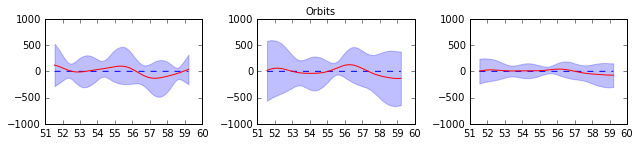

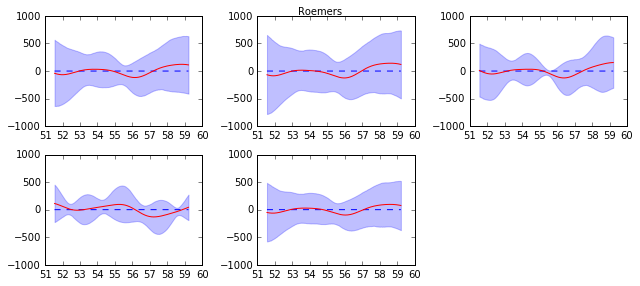

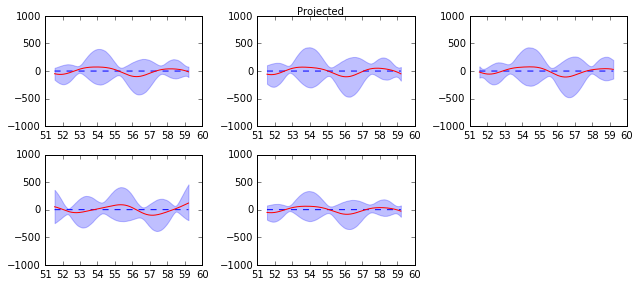

In [590]:
analyze('de436t.bsp','de436t.bsp',zerosaturn=True)

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


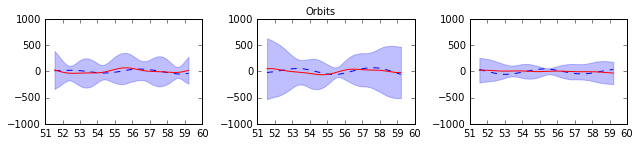

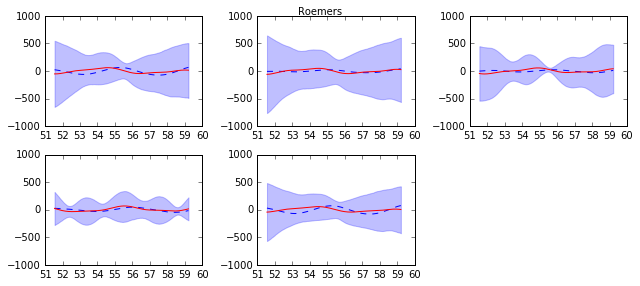

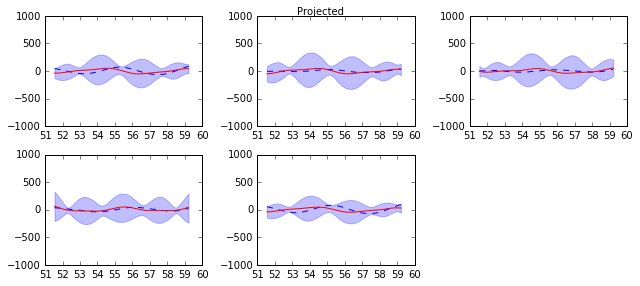

In [591]:
analyze('de435t.bsp','de436t.bsp',zerosaturn=True)

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


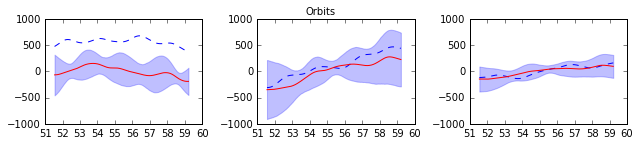

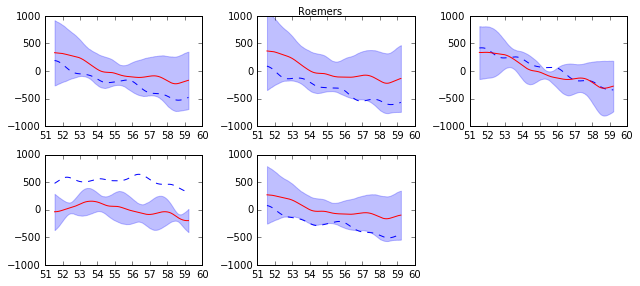

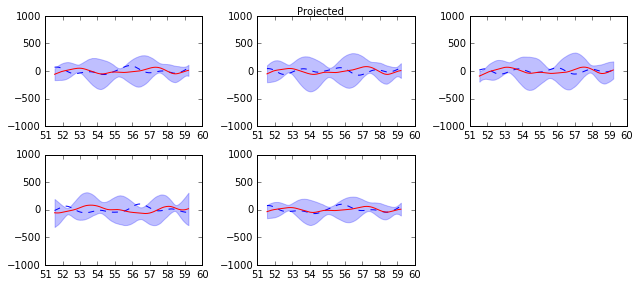

In [592]:
analyze('de430t.bsp','de436t.bsp',zerosaturn=True)

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


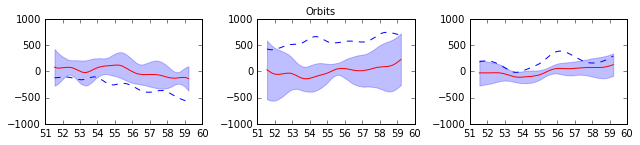

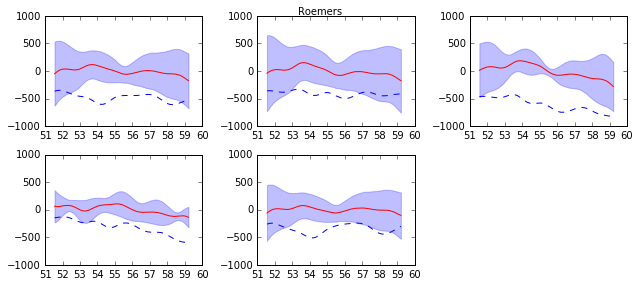

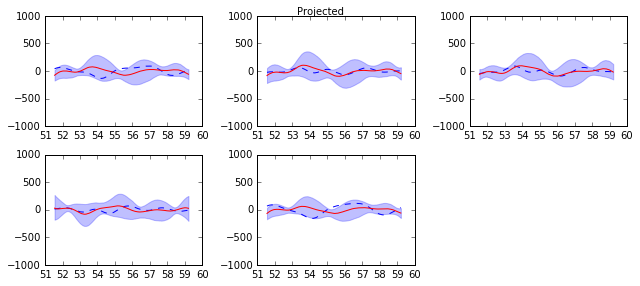

In [593]:
analyze('de421.bsp','de436t.bsp',zerosaturn=True)

Loading...
Refitting...
Percentiles...
Plotting...
Projecting...


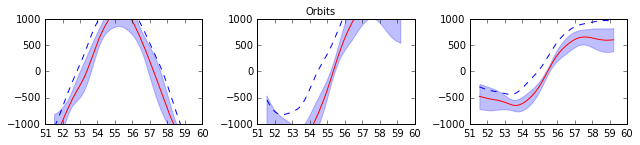

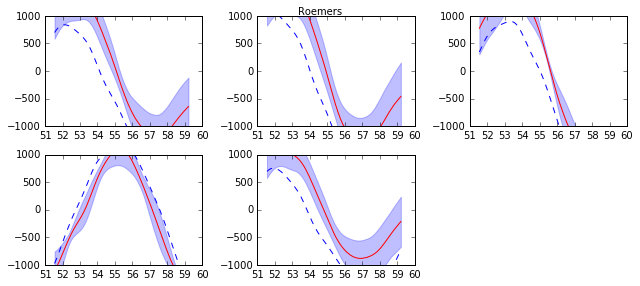

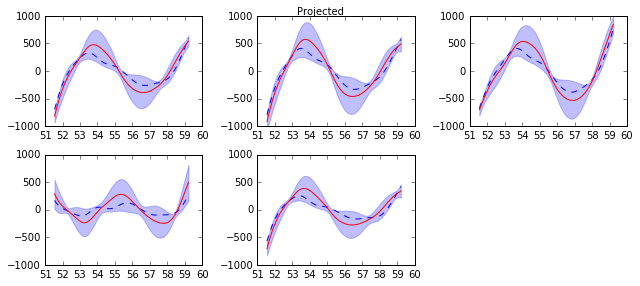

In [594]:
analyze('de418.bsp','de436t.bsp',zerosaturn=True)

## Orbital element uncertainties from Bill

In [124]:
APCSCALE = 6
APCNAME = ['DMW5','DP5','DQ5','EDW5','DA5','DE5']

APCOV1 = np.zeros((6,6),'d')

APCOV1[0,0:1] = [ 1.527621387618E-15]
APCOV1[1,0:2] = [ 1.058311905401E-16,  9.908144821626E-16]
APCOV1[2,0:3] = [ 1.325206907371E-16,  7.800126497261E-16,  1.484869687029E-15]
APCOV1[3,0:4] = [-5.554347232525E-17, -1.805266759308E-18, -3.219245713312E-18,  3.943475941450E-18]
APCOV1[4,0:5] = [ 5.829025102220E-17,  2.411095852154E-18,  3.120922611115E-18, -1.149409771728E-18,  2.730094171917E-18]
APCOV1[5,0:6] = [-1.517335230324E-16, -1.514060345995E-17, -1.982573561138E-17,  7.340771399985E-18, -4.843232999649E-18,  1.686941960642E-17]

for i in range(6):
    for j in range(i+1,6):
        APCOV1[i,j] = APCOV1[j,i]

pip install fortran_magic

In [125]:
%load_ext fortranmagic

/Users/vallis/miniconda3/lib/python3.5/site-packages/IPython/utils/path.py:265: UserWarning: get_ipython_cache_dir has moved to the IPython.paths module
  warn("get_ipython_cache_dir has moved to the IPython.paths module")


In [126]:
%%fortran
      SUBROUTINE VCROSS(a, b, cross)
      REAL(8), DIMENSION(3), INTENT(IN) :: a, b
      REAL(8), DIMENSION(3), INTENT(OUT) :: cross

      cross(1) = a(2) * b(3) - a(3) * b(2)
      cross(2) = a(3) * b(1) - a(1) * b(3)
      cross(3) = a(1) * b(2) - a(2) * b(1)
      END SUBROUTINE VCROSS

      SUBROUTINE EMSMAG(R,SR)
      REAL(8), DIMENSION(3), INTENT(IN) :: R
      REAL(8), INTENT(OUT) :: SR
    
      SR = SQRT(R(1)*R(1) + R(2)*R(2) + R(3)*R(3))
      END SUBROUTINE EMSMAG
    
      SUBROUTINE EMSDOT(a, b, dot)
      REAL(8), DIMENSION(3), INTENT(IN) :: a, b
      REAL(8), INTENT(OUT) :: dot
            
      dot = a(1)*b(1) + a(2)*b(2) + a(3)*b(3)
      END SUBROUTINE EMSDOT
    
      SUBROUTINE VNORM(v, norm)
      REAL(8), DIMENSION(3), INTENT(INOUT) :: v
      REAL(8), INTENT(OUT) :: norm
            
      CALL EMSMAG(v, norm)
    
      DO 1 I=1,3
   1  v(I) = v(I) / norm
      END SUBROUTINE VNORM
    
      SUBROUTINE S3PAR6(RMU,R,PX)   

c SET III Formulation of Brouwer & Clemence (pg.241)
c
c     S3PAR6(RMU,R,PX)
c
c                   d(x,y,z,x-dot,y-dot,z-dot)
c     computes PX = --------------------------
c                         d(set III)
c
c
c     where   setIII = DMWi, DPi, DQi, EDWi, DAi, DEi
c
c             RMU = GMsun + GMi
c
c             R = x, y, z, x-dot, y-dot, z-dot, t-t0
c
c     Note : t-t0 is time since epoch of partials
c
c     in  [ (au) and (au/day) / (radians) ]
c
c The formulation follows (Standish JPL IOM 314.6-629, 1985)

      IMPLICIT DOUBLE PRECISION (A-H,O-Z)
      REAL(8), INTENT(IN) :: RMU
      REAL(8), DIMENSION(7), INTENT(IN) :: R
      REAL(8), DIMENSION(6,6), INTENT(OUT) :: PX
            
      REAL(8), DIMENSION(3,3) :: PQR
      REAL(8), DIMENSION(8) :: W

      save

c     R = r X r-dot 

      CALL VCROSS(R,R(4),PQR(1,3))   


c     P = r-dot X h  -  mu * r-cap   (Danby, pg 122)

      CALL VCROSS(R(4),PQR(1,3),PQR(1,1))  

      CALL EMSMAG(R,SR)   
      DO 1 I=1,3  
   1  PQR(I,1)=PQR(I,1)-RMU*R(I)/SR 


c     Q = R X P

      CALL VCROSS(PQR(1,3),PQR(1,1),PQR(1,2))    


c Normalize P, Q, R

      DO 2 I=1,3  
   2  CALL VNORM(PQR(1,I),SH) 


c  Compute v**2, r r-dot, a, n, (1-ee), ee, e, ae(1-ee)

      CALL EMSDOT(R(4),R(4),VV) 
      CALL EMSDOT(R,R(4),RRD)   

      A=SR*RMU/(2.D0*RMU-SR*VV)     
      EN=DSQRT(RMU/A**3)
      PAR=SH*SH/(RMU*A) 
      EE=1.D0-PAR 
      E=DSQRT(EE) 
      AEPAR=A*E*PAR     

C  H adn K  (Brouwer & Clemence, pg. 237)

      CH=(SR-A*(1.D0+EE))/AEPAR     
      CK=(RRD/((A*EN)**2*E))*(1.D0+SR/(A*PAR))  

c  H-dot and K-dot

      CHD=RRD/(SR*AEPAR)
      CKD=(2.D0*(A-SR)+A*EE)/AEPAR  
C     
      FAC=-RMU/SR**3    

c  Load r, r-dot and r-dot-dot into W

      DO 3 I=1,3  
      W(I)=R(I)   
      W(I+3)=R(I+3)     
   3  W(I+6)=FAC*W(I)   

c  DP = P X r; DQ = Q X r; EDW = (- r-dot/n + R X r)/e

c  P X r, P X r-dot, Q X r, Q X r-dot, R X r and R X r-dot into PX

      DO 4 I=1,4,3
      DO 4 J=1,3  
   4  CALL VCROSS(PQR(1,J),R(I),PX(I,J+1)) 
   

      DO 5 I=1,6  

c  DMW = r-dot / n

      PX(I,1)=W(I+3)/EN 

c  DA = r - 3/2 t r-dot; r-dot - 3/2 t r-dot-dot - 3/2 r-dot

      PX(I,5)=W(I)-1.5D0*R(7)*W(I+3)

c  DE = H r + K r-dot, 
c          H r-dot + K r-dot-dot  +  h-dot r + K-dot r-dot

      PX(I,6)=CH*W(I)+CK*W(I+3)     

c  (finish the rest of EDW)

   5  PX(I,4)=(PX(I,4)-W(I+3)/EN)/E 


      DO 6 I=1,3  

c  (finish the last term of DA)

      PX(I+3,5)=PX(I+3,5)-1.5D0*W(I+3)    

c  (finish the last terms of DE)

   6  PX(I+3,6)=PX(I+3,6)+CHD*W(I)+CKD*W(I+3)   
              
      RETURN
      END

In [127]:
jup = jupiter()

au_over_sec = cmsec / AU

def xxdot(dates,equatorial=True,tref=2440400.5):
    getcoords = jup.helio_eq_coords if equatorial else jup.helio_ecl_coords
    
    if not isinstance(dates,np.ndarray):
        dates = np.array(dates)
    if dates.ndim == 0:
        dates = dates[np.newaxis]
    
    x = au_over_sec * getcoords(dates,[0]*6)
    xdot = au_over_sec * (getcoords(dates + 1,[0]*6) - getcoords(dates - 1,[0]*6)) / 2
    t = dates - tref
    
    res = np.hstack((x, xdot, t[:,np.newaxis]))
    
    if res.shape[0] == 1:
        return res[0,:]
    else:
        return res

In [128]:
GMsun = 1.32712440041e20 / (AU**3 / 86400**2) # m3s−2 -> AU3d-2

In [129]:
Msun_over_Mjup = 1.047348644e3
GMjup = GMsun / Msun_over_Mjup

From Bill Folkner:

    Partials at time no.   1  01-JAN-2000 00:00:00.0000
                    Julian date    0.2451544500000000D+07
                    Seconds past reference   -0.4320000000000000D+05


    JUPITE      DA5

                  POS
    X      1.20262807773396D+10
    Y     -1.43268663380316D+10
    Z     -6.43391905757151D+09

    JUPITE      DE5

                  POS
    X     -9.11401212616218D+08
    Y      1.03431995771853D+07
    Z      2.66046657997218D+07

    JUPITE      DP5

                  POS
    X      6.40787059136829D+06
    Y     -1.10614953336483D+08
    Z      2.57569281635618D+08

    JUPITE      DQ5

                  POS
    X     -1.52733213343214D+07
    Y      2.70497680446158D+08
    Z     -6.31741799726461D+08

    JUPITE      DMW5

                  POS
    X     -4.73450349092525D+08
    Y      6.09298914468547D+08
    Z      2.72692531635397D+08

    JUPITE      EDW5

                  POS
    X      6.06449895432699D+08
    Y     -1.21734424415590D+09
    Z     -5.36536559398573D+08

In [56]:
# order in s3par6 output: DMWi, DPi, DQi, EDWi, DAi, DEi
#                         0     1    2    3     4    5

In [130]:
for par, ind in [('DA',4),('DE',5),('DP',1),('DQ',2),('DMW',0),('EDW',3)]:
    print(par, AU * s3par6(GMsun + GMjup, xxdot(0.2451544500000000e7,equatorial=True,tref=2451544.0))[:3,ind] / 1e3)

DA [  5.98994506e+08   4.09268941e+08   1.60820210e+08]
DE [ -9.15270732e+08   1.37601112e+07   2.81936899e+07]
DP [  6.13249497e+06  -1.07896467e+08   2.51742875e+08]
DQ [ -1.54620776e+07   2.72043200e+08  -6.34728263e+08]
DMW [ -4.71070334e+08   6.06268208e+08   2.71320625e+08]
EDW [  6.40207643e+08  -1.24035067e+09  -5.47207245e+08]


In [131]:
l = np.linalg.cholesky(APCOV1)

In [132]:
r = np.var([np.dot(l, np.random.randn(6)) for i in range(100000)],axis=0)

In [133]:
r

array([  1.53489198e-15,   9.88900450e-16,   1.48691787e-15,
         3.95429921e-18,   2.73542954e-18,   1.69598017e-17])

In [134]:
np.diag(APCOV1)

array([  1.52762139e-15,   9.90814482e-16,   1.48486969e-15,
         3.94347594e-18,   2.73009417e-18,   1.68694196e-17])

In [135]:
partial = np.zeros((6,len(jdates),3),'d')

for i in range(len(jdates)):
    partial[:,i,:] = s3par6(GMsun + GMjup, xxdot(jdates[i]))[:3,:].T

In [136]:
def randx():
    de = np.dot(l, np.random.randn(6))
    
    return AU * np.einsum('ijk,i->jk',partial,de)

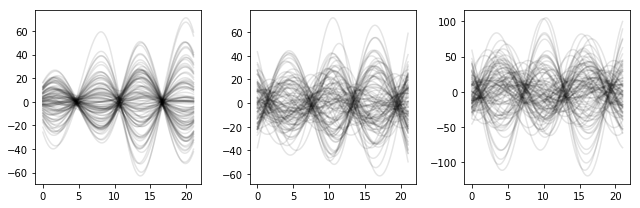

In [137]:
pp.figure(figsize=(9,3))

for i in range(100):
    dx = randx()

    for i in range(3):
        pp.subplot(1,3,i+1)
        pp.plot((dates - dates[0])/365.25, dx[:,i]/1e3, 'k', alpha=0.1) # ns

pp.tight_layout()

In [138]:
def randy():
    return randx() / cmsec / Msun_over_Mjup

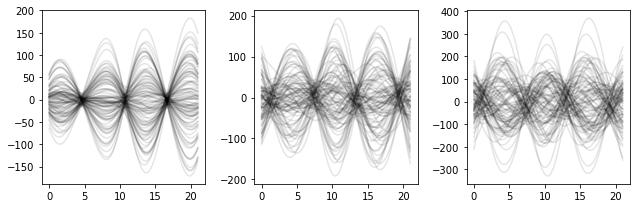

In [139]:
pp.figure(figsize=(9,3))

for i in range(100):
    dy = randy()

    for i in range(3):
        pp.subplot(1,3,i+1)
        pp.plot((dates - dates[0])/365.25, 1e9*dy[:,i], 'k', alpha=0.1) # ns

pp.tight_layout()

In [140]:
psrpos = pickle.load(open('truepsrpos.pickle','rb'))

In [141]:
psrlist = list(psrpos.values())

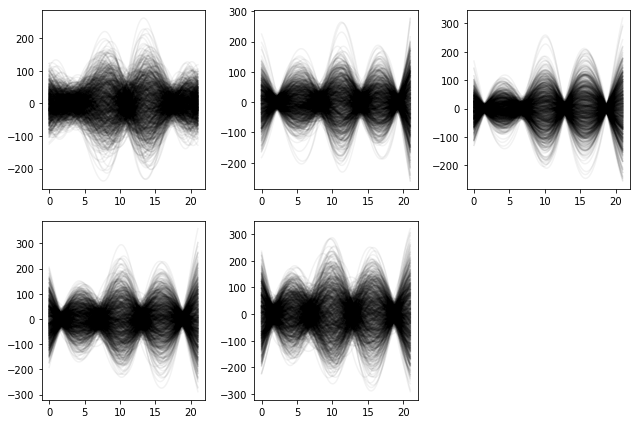

In [142]:
pp.figure(figsize=(9,6))

for i in range(1000):
    dy = randy()

    for i in range(5):
        r = project(dates, 1e9*np.dot(dy,psrlist[i]))
        
        pp.subplot(2,3,i+1)
        pp.plot((dates - dates[0])/365.25, r, 'k', alpha=0.05) # ns

pp.tight_layout()

In [143]:
partials = (AU / cmsec) * partial # seconds

In [144]:
M = np.zeros((6,6),'d')

for i in range(6):
    for j in range(6):
        M[i,j] = np.einsum('ij,ij',partials[i,:,:],jupiter_svd[j,:,:])

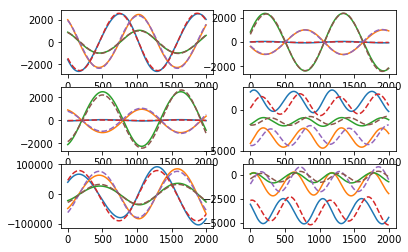

In [145]:
for i in range(6):
    pp.subplot(3,2,i+1)
    pp.plot(partials[i,:,:])
    pp.plot(np.einsum('j,jkl->kl',M[i,:],jupiter_svd),'--')

* Re-express partials from SVD basis: $P_{i \mu} = M_{ij} S_{j \mu}$.
* $P_{j \mu} c_j = S_{j \mu} b_j$ implies $M_{ij} S_{j \mu} c_i = S_{j \mu} b_j$, so $M_{ij} c_i = b_j$.
* $\langle b_i b_j \rangle = \langle M_{ki} c_k M_{lj} c_l \rangle = M_{ki} \langle c_k c_l \rangle M_{lj}$.

In [147]:
c2 = np.dot(np.linalg.inv(M),np.array([0,0,1,0,0,0]))

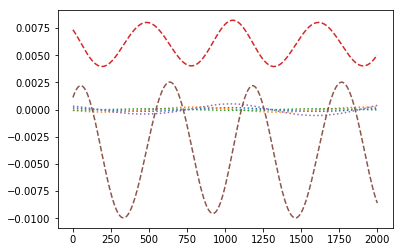

In [148]:
i = 2

pp.plot(np.einsum('i,ijk->jk',np.array([c2[0]] + [0]*5),partials)[:,i],':')
pp.plot(np.einsum('i,ijk->jk',np.array([0]*1 + [c2[1]] + [0]*4),partials)[:,i],':')
pp.plot(np.einsum('i,ijk->jk',np.array([0]*2 + [c2[2]] + [0]*3),partials)[:,i],':')
pp.plot(np.einsum('i,ijk->jk',np.array([0]*3 + [c2[3]] + [0]*2),partials)[:,i],'--')
pp.plot(np.einsum('i,ijk->jk',np.array([0]*4 + [c2[4]] + [0]*1),partials)[:,i],':')
pp.plot(np.einsum('i,ijk->jk',np.array([0]*5 + [c2[5]]),partials)[:,i],'--')

In [149]:
bcov = np.dot(np.dot(M.T,APCOV1),M)

In [150]:
ll = np.linalg.cholesky(bcov)

In [151]:
def randz():
    db = np.dot(ll, np.random.randn(6))
    
    return np.einsum('i,ijk->jk',db,jupiter_svd)

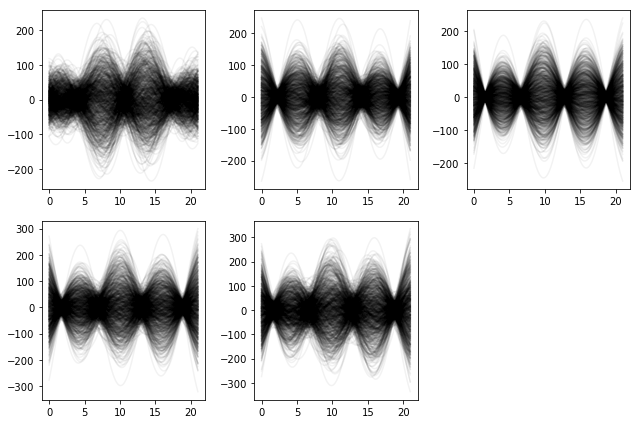

In [152]:
pp.figure(figsize=(9,6))

for i in range(1000):
    dz = randz() / 1e3

    for i in range(5):
        r = project(dates, 1e9*np.dot(dz,psrlist[i]))
        
        pp.subplot(2,3,i+1)
        pp.plot((dates - dates[0])/365.25, r, 'k', alpha=0.05) # ns

pp.tight_layout()

In [153]:
bcov

array([[  3.02523645e-06,   3.97004662e-06,   2.24903984e-07,
         -2.66611739e-07,  -4.71190041e-08,   1.30078749e-07],
       [  3.97004662e-06,   5.23961306e-06,   3.63693174e-07,
         -1.97032683e-07,  -1.36506909e-07,   9.00474450e-09],
       [  2.24903984e-07,   3.63693174e-07,   2.39866742e-07,
         -2.80080126e-07,  -2.31449063e-07,   1.89317437e-07],
       [ -2.66611739e-07,  -1.97032683e-07,  -2.80080126e-07,
          9.73091356e-06,   1.04977834e-07,  -4.69086192e-06],
       [ -4.71190041e-08,  -1.36506909e-07,  -2.31449063e-07,
          1.04977834e-07,   2.37264475e-07,  -8.60592321e-08],
       [  1.30078749e-07,   9.00474450e-09,   1.89317437e-07,
         -4.69086192e-06,  -8.60592321e-08,   6.31390395e-06]])

In [154]:
np.sqrt(np.diag(bcov))

array([ 0.00173932,  0.00228902,  0.00048976,  0.00311944,  0.0004871 ,
        0.00251275])

## Latest 11-yr PCA runs

In [159]:
mv /Users/vallis/Downloads/michele_pca_posteriors.npz ./michele_epphysmodel_nosat_nano11yr_pca.npz

In [82]:
mv /Users/vallis/Downloads/michele_pca_posteriors_11yrLikeSims.npz ./michele_epphysmodel_nosat_sim11yr_pca.npz

    a=chain_de435_noprior
    b=chain_de435,
    c=chain_de436_noprior
    d=chain_de436

In [64]:
def binloadpars(filename, eph='a'):
    chain = np.load(filename)[eph]
    
    return chain[:,68:80]

In [65]:
de435 = binloadpars('michele_epphysmodel_nosat_nano11yr_pca.npz','a')
de435_pca = binloadpars('michele_epphysmodel_nosat_nano11yr_pca.npz','b')

de436 = binloadpars('michele_epphysmodel_nosat_nano11yr_pca.npz','c')
de436_pca = binloadpars('michele_epphysmodel_nosat_nano11yr_pca.npz','d')

In [84]:
sim435 = binloadpars('michele_epphysmodel_nosat_sim11yr_pca.npz','a')
sim435_pca = binloadpars('michele_epphysmodel_nosat_sim11yr_pca.npz','b')

sim436 = binloadpars('michele_epphysmodel_nosat_sim11yr_pca.npz','c')
sim436_pca = binloadpars('michele_epphysmodel_nosat_sim11yr_pca.npz','d')

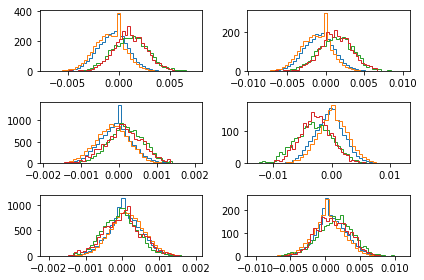

In [105]:
for i in range(6):
    pp.subplot(3,2,i+1)

    pp.hist(de435_pca[20000:,-6+i],histtype='step',bins=40,color='C0',normed=True)
    pp.hist(de436_pca[20000:,-6+i],histtype='step',bins=40,color='C1',normed=True)

    pp.hist(sim435_pca[20000:,-6+i],histtype='step',bins=40,color='C2',normed=True)    
    pp.hist(sim436_pca[20000:,-6+i],histtype='step',bins=40,color='C3',normed=True)

pp.tight_layout()

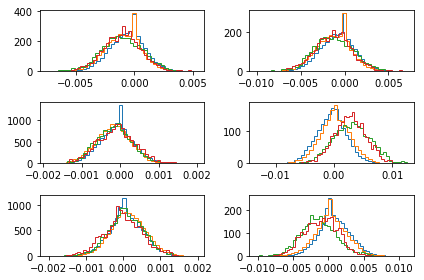

In [124]:
for i in range(6):
    pp.subplot(3,2,i+1)

    pp.hist(de435_pca[20000:,-6+i],histtype='step',bins=40,color='C0',normed=True)
    pp.hist(de436_pca[20000:,-6+i],histtype='step',bins=40,color='C1',normed=True)

    pp.hist(-sim435_pca[20000:,-6+i],histtype='step',bins=40,color='C2',normed=True)    
    pp.hist(-sim436_pca[20000:,-6+i],histtype='step',bins=40,color='C3',normed=True)

pp.tight_layout()

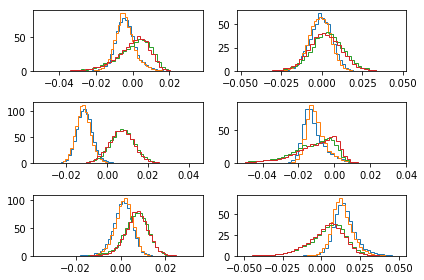

In [128]:
for i in range(6):
    pp.subplot(3,2,i+1)

    pp.hist(de435[20000:,-6+i],histtype='step',bins=40,color='C0',normed=True)
    pp.hist(de436[20000:,-6+i],histtype='step',bins=40,color='C1',normed=True)

    pp.hist(sim435[20000:,-6+i],histtype='step',bins=40,color='C2',normed=True)    
    pp.hist(sim436[20000:,-6+i],histtype='step',bins=40,color='C3',normed=True)

pp.tight_layout()

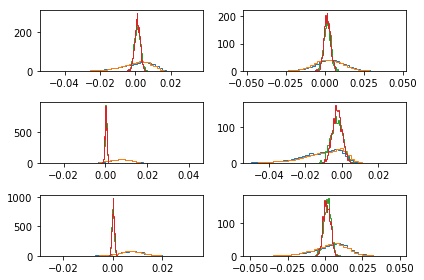

In [89]:
for i in range(6):
    pp.subplot(3,2,i+1)

    pp.hist(sim435[20000:,-6+i],histtype='step',bins=40,color='C0',normed=True)
    pp.hist(sim436[20000:,-6+i],histtype='step',bins=40,color='C1',normed=True)

    pp.hist(sim435_pca[20000:,-6+i],histtype='step',bins=40,color='C2',normed=True)    
    pp.hist(sim436_pca[20000:,-6+i],histtype='step',bins=40,color='C3',normed=True)

pp.tight_layout()

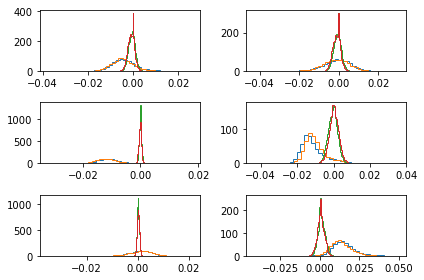

In [66]:
for i in range(6):
    pp.subplot(3,2,i+1)

    pp.hist(de435[:,-6+i],histtype='step',bins=40,color='C0',normed=True)
    pp.hist(de436[:,-6+i],histtype='step',bins=40,color='C1',normed=True)

    pp.hist(de435_pca[:,-6+i],histtype='step',bins=40,color='C2',normed=True)    
    pp.hist(de436_pca[:,-6+i],histtype='step',bins=40,color='C3',normed=True)

pp.tight_layout()

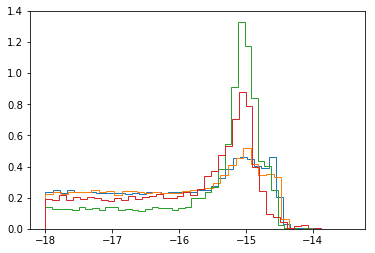

In [139]:
pp.hist(sim435[:,0],histtype='step',bins=40,color='C0',normed=True)
pp.hist(sim436[:,0],histtype='step',bins=40,color='C1',normed=True)

pp.hist(sim435_pca[:,0],histtype='step',bins=40,color='C2',normed=True);    
pp.hist(sim436_pca[:,0],histtype='step',bins=40,color='C3',normed=True);

# pp.axis(ymax=0.6); pp.yscale('log')

In [143]:
sim436_noeph = np.loadtxt('michele_epphysmodel_nosat_sim11yr_noeph/chain_1.txt')

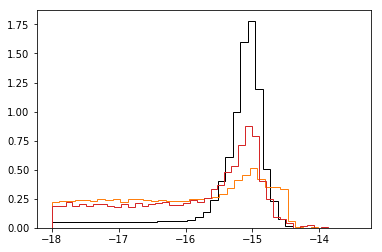

In [146]:
pp.hist(sim436_noeph[:,68],histtype='step',bins=40,color='k',normed=True)
pp.hist(sim436[:,0],histtype='step',bins=40,color='C1',normed=True)
pp.hist(sim436_pca[:,0],histtype='step',bins=40,color='C3',normed=True);

# pp.axis(ymax=0.6); pp.yscale('log')

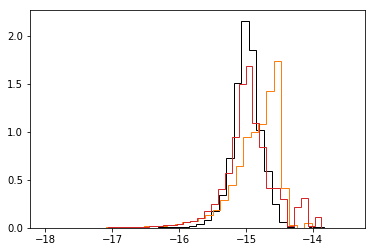

In [145]:
pp.hist(sim436_noeph[:,68],histtype='step',bins=40,color='k',normed=True,weights=10**sim436_noeph[:,68])
pp.hist(sim436[:,0],histtype='step',bins=40,color='C1',normed=True,weights=10**sim436[:,0])
pp.hist(sim436_pca[:,0],histtype='step',bins=40,color='C3',normed=True,weights=10**sim436_pca[:,0]);

# pp.axis(ymax=0.6); pp.yscale('log')

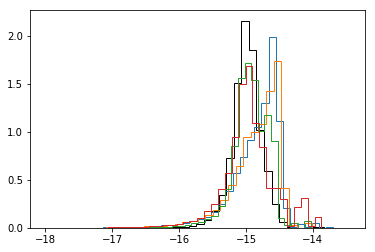

In [144]:
pp.hist(sim436_noeph[:,68],histtype='step',bins=40,color='k',normed=True,weights=10**sim436_noeph[:,68])

pp.hist(sim435[:,0],histtype='step',bins=40,color='C0',normed=True,weights=10**sim435[:,0])
pp.hist(sim436[:,0],histtype='step',bins=40,color='C1',normed=True,weights=10**sim436[:,0])

pp.hist(sim435_pca[:,0],histtype='step',bins=40,color='C2',normed=True,weights=10**sim435_pca[:,0]);    
pp.hist(sim436_pca[:,0],histtype='step',bins=40,color='C3',normed=True,weights=10**sim436_pca[:,0]);

# pp.axis(ymax=0.6); pp.yscale('log')

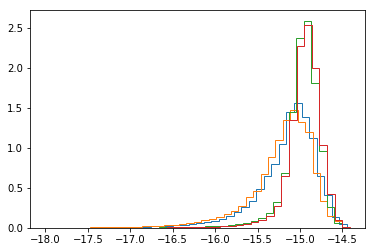

In [138]:
pp.hist(de435[:,0],histtype='step',bins=40,color='C0',normed=True,weights=10**de435[:,0])
pp.hist(de436[:,0],histtype='step',bins=40,color='C1',normed=True,weights=10**de436[:,0])

pp.hist(de435_pca[:,0],histtype='step',bins=40,color='C2',normed=True,weights=10**de435_pca[:,0])    
pp.hist(de436_pca[:,0],histtype='step',bins=40,color='C3',normed=True,weights=10**de436_pca[:,0]);

# pp.axis(ymax=0.6); pp.yscale('log')

In [60]:
import corner

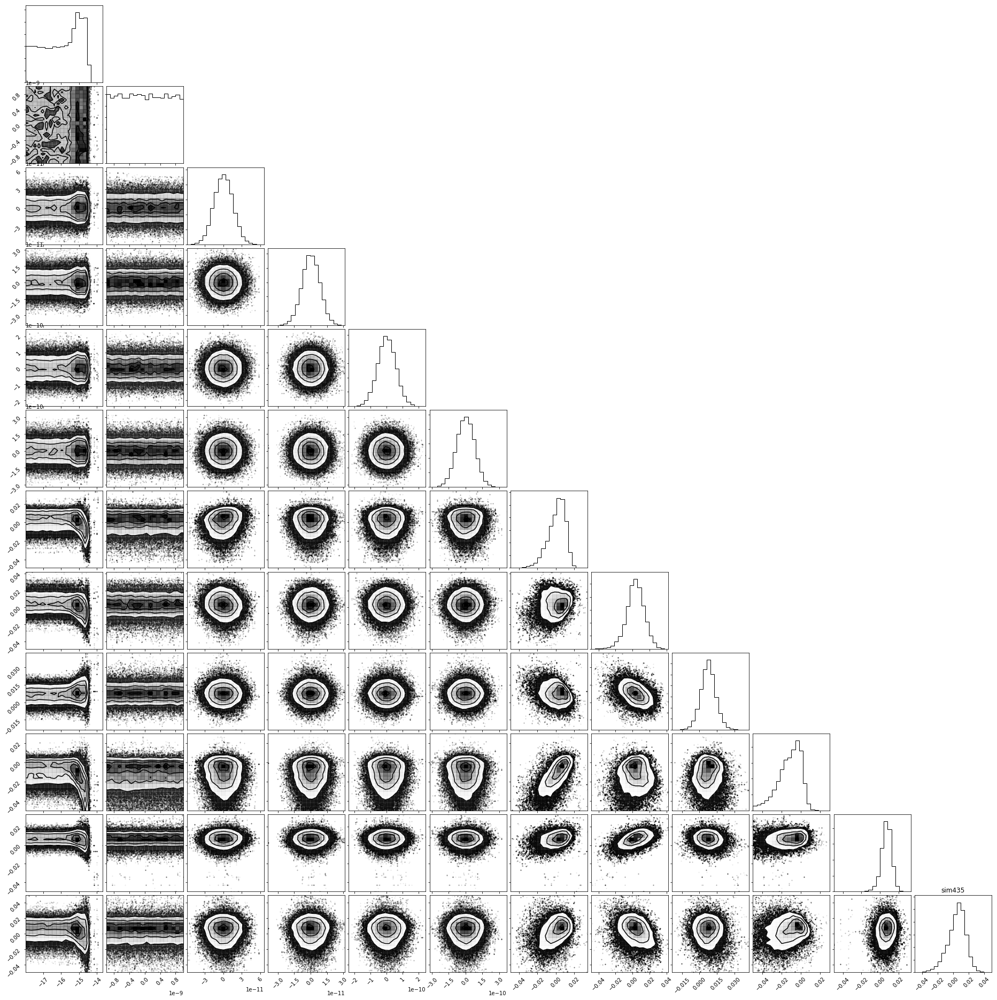

In [115]:
corner.corner(sim435[:,:]);
pp.savefig('/Users/vallis/Dropbox/sim435.png')

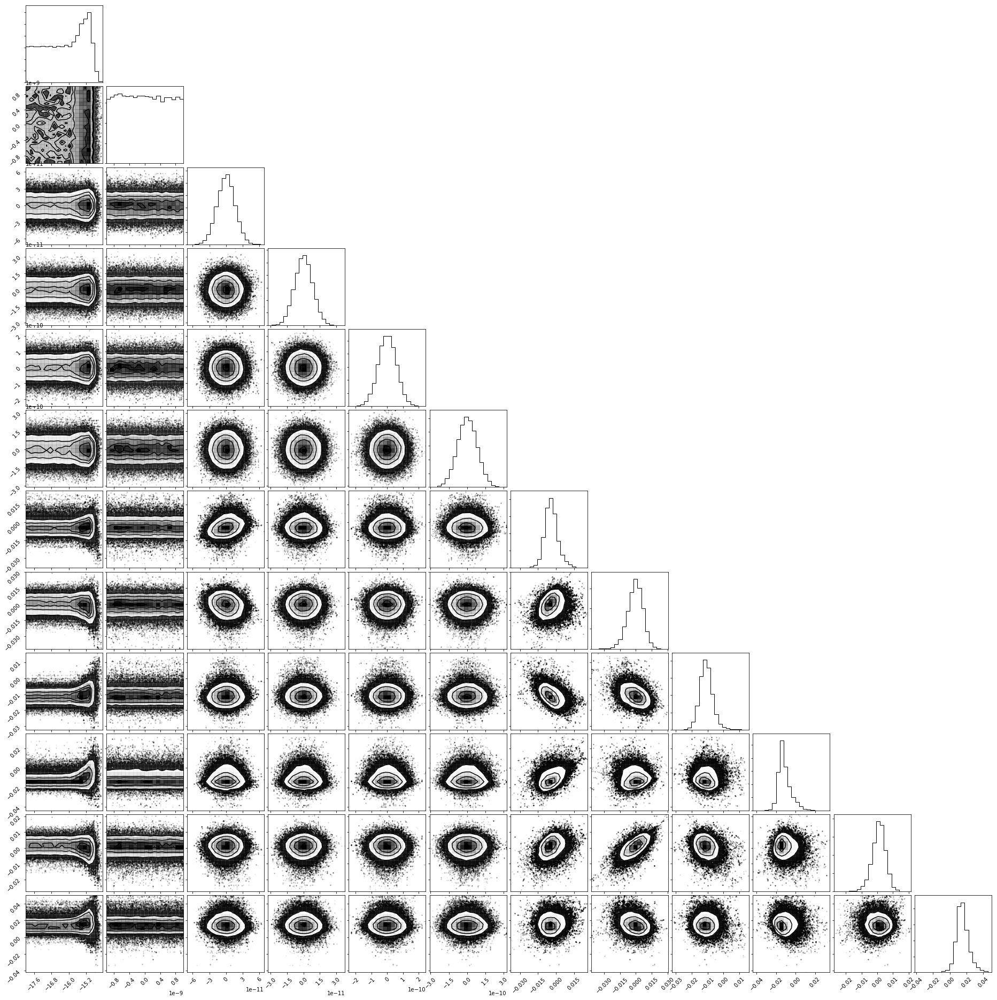

In [116]:
corner.corner(de435[:,:]);
pp.savefig('/Users/vallis/Dropbox/de435.png')

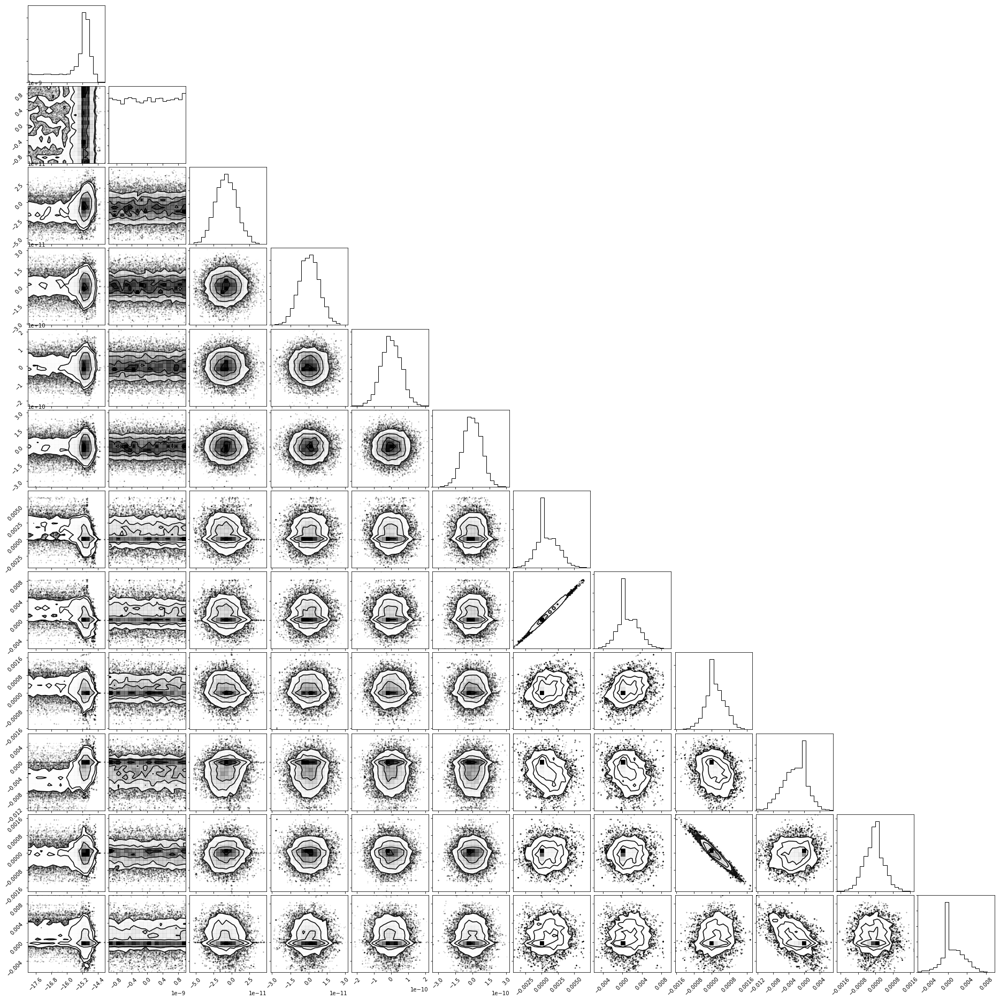

In [117]:
corner.corner(sim435_pca[:,:]);
pp.savefig('/Users/vallis/Dropbox/sim435_pca.png')

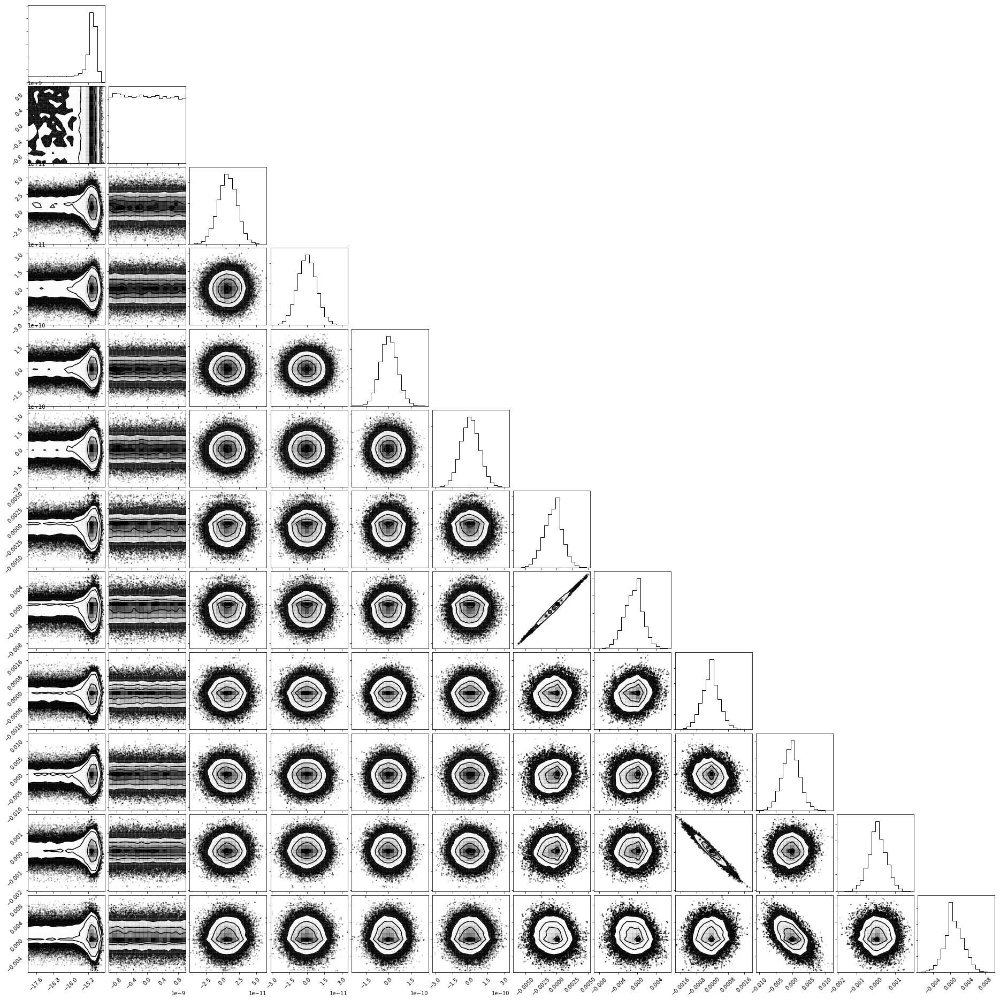

In [118]:
corner.corner(de435_pca[:,:]);
pp.savefig('/Users/vallis/Dropbox/de435_pca.png')

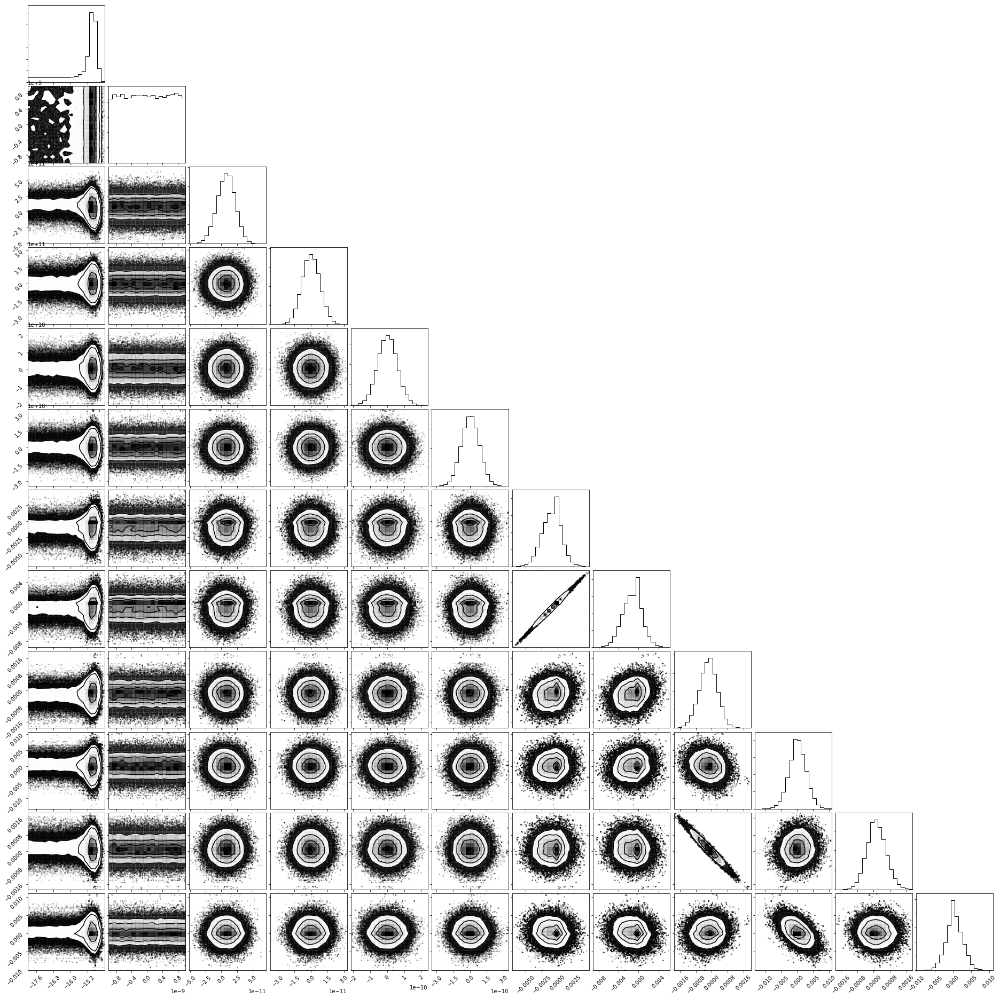

In [119]:
corner.corner(de436_pca[:,:]);
pp.savefig('/Users/vallis/Dropbox/de436_pca.png')

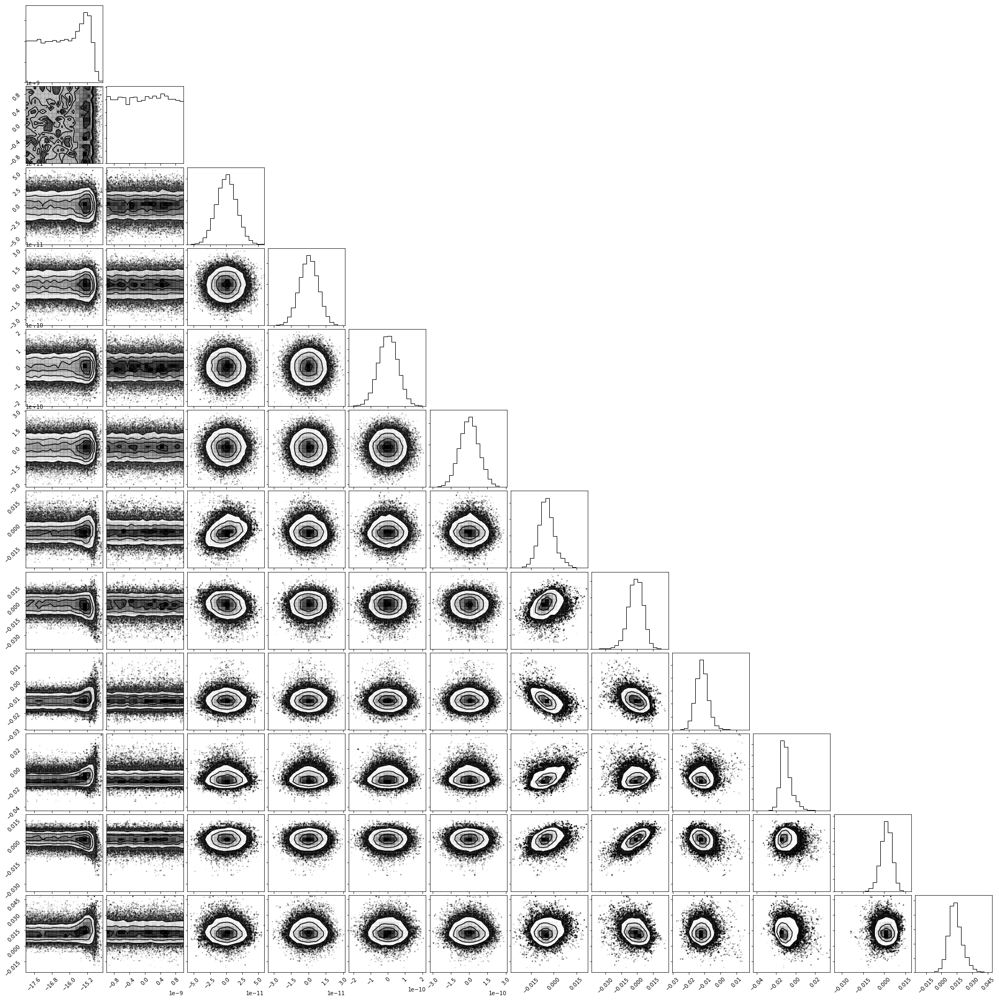

In [120]:
corner.corner(de436[:,:]);
pp.savefig('/Users/vallis/Dropbox/de436.png')

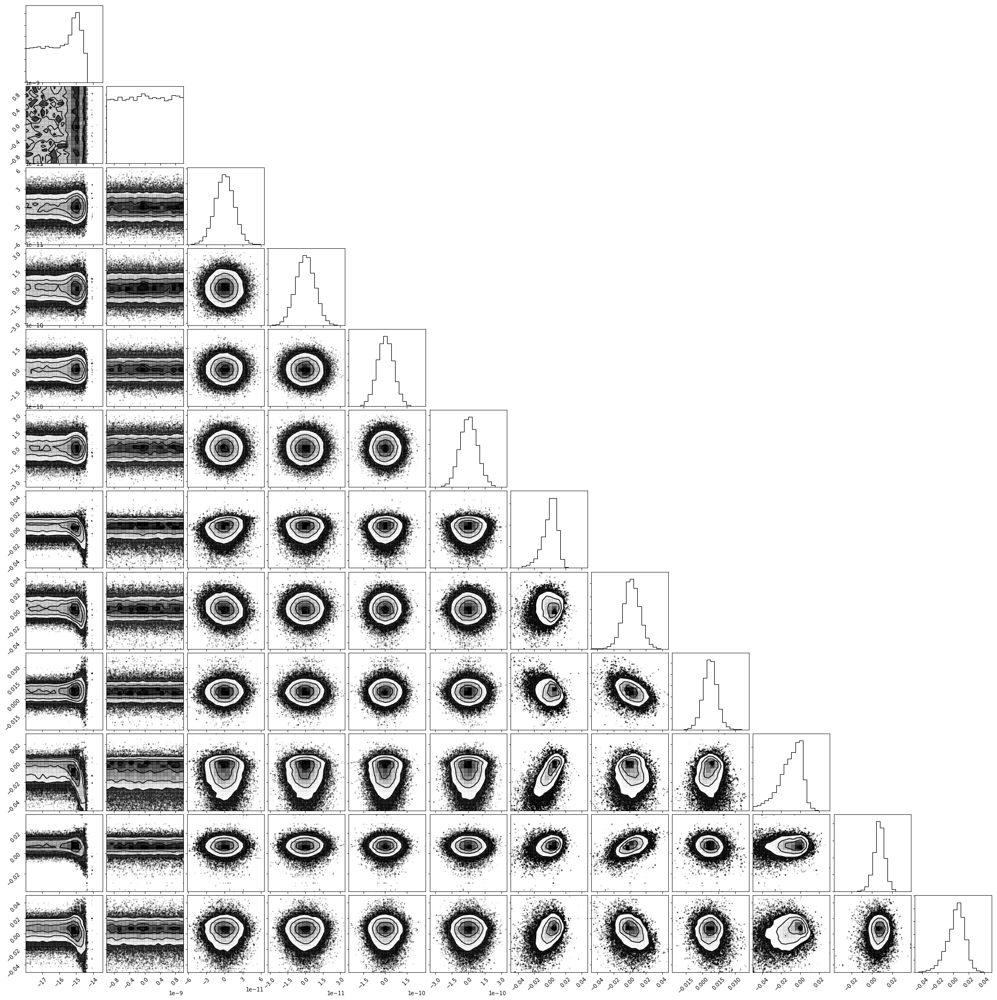

In [121]:
corner.corner(sim436[:,:]);
pp.savefig('/Users/vallis/Dropbox/sim436.png')c

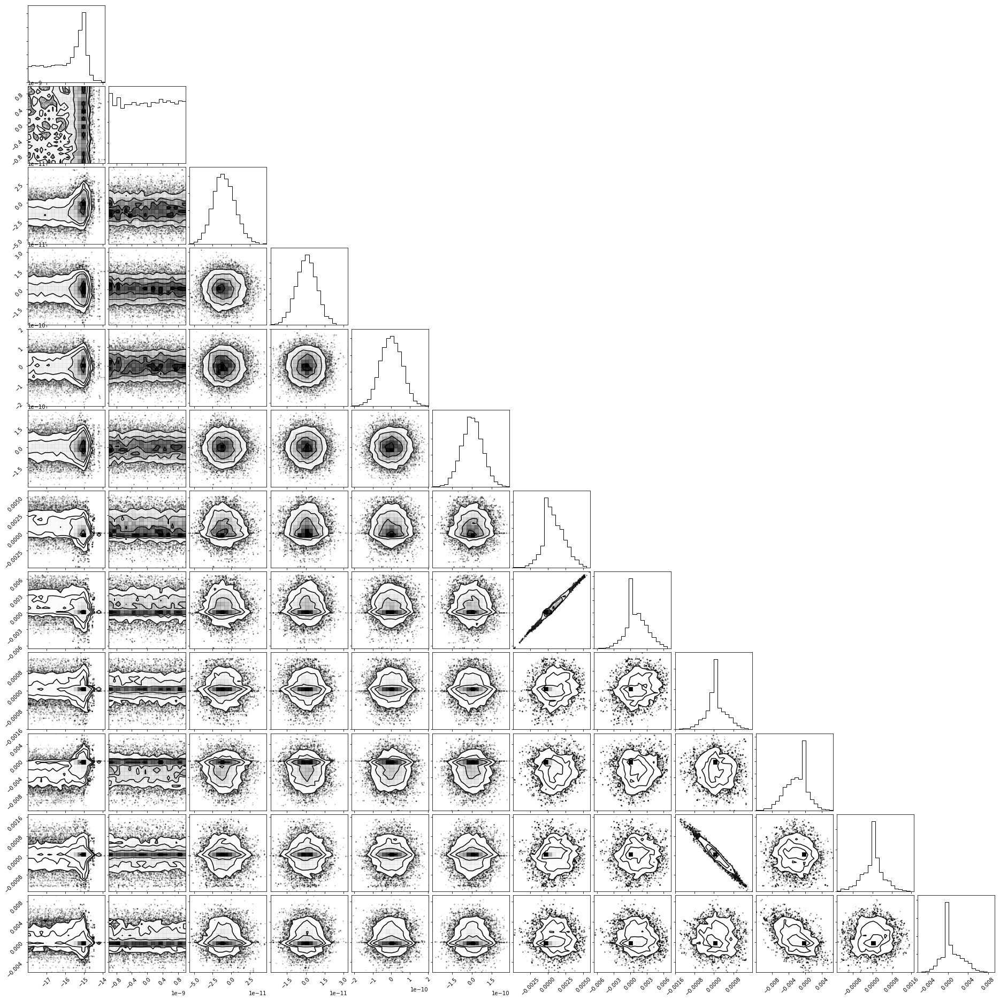

In [122]:
corner.corner(sim436_pca[:,:]);
pp.savefig('/Users/vallis/Dropbox/sim436_pca.png')

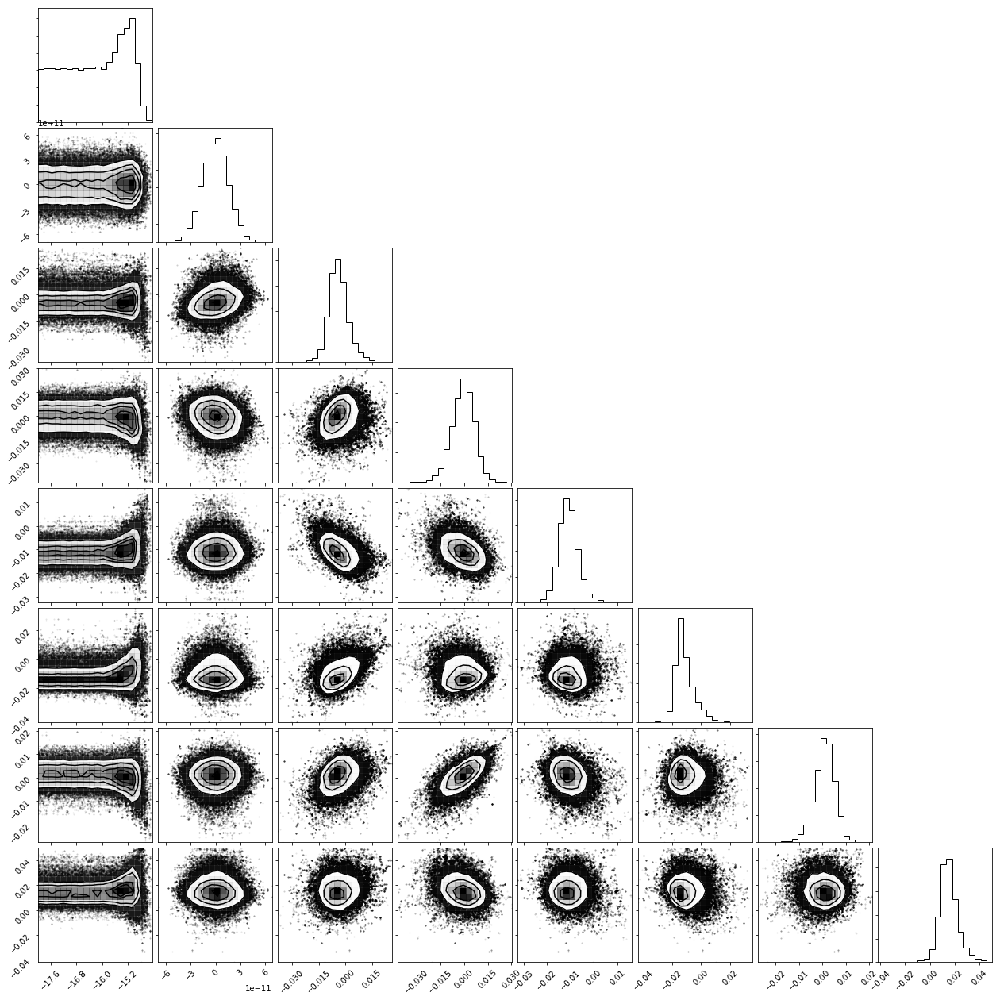

In [92]:
corner.corner(de435[:,[0,2,-6,-5,-4,-3,-2,-1]]);

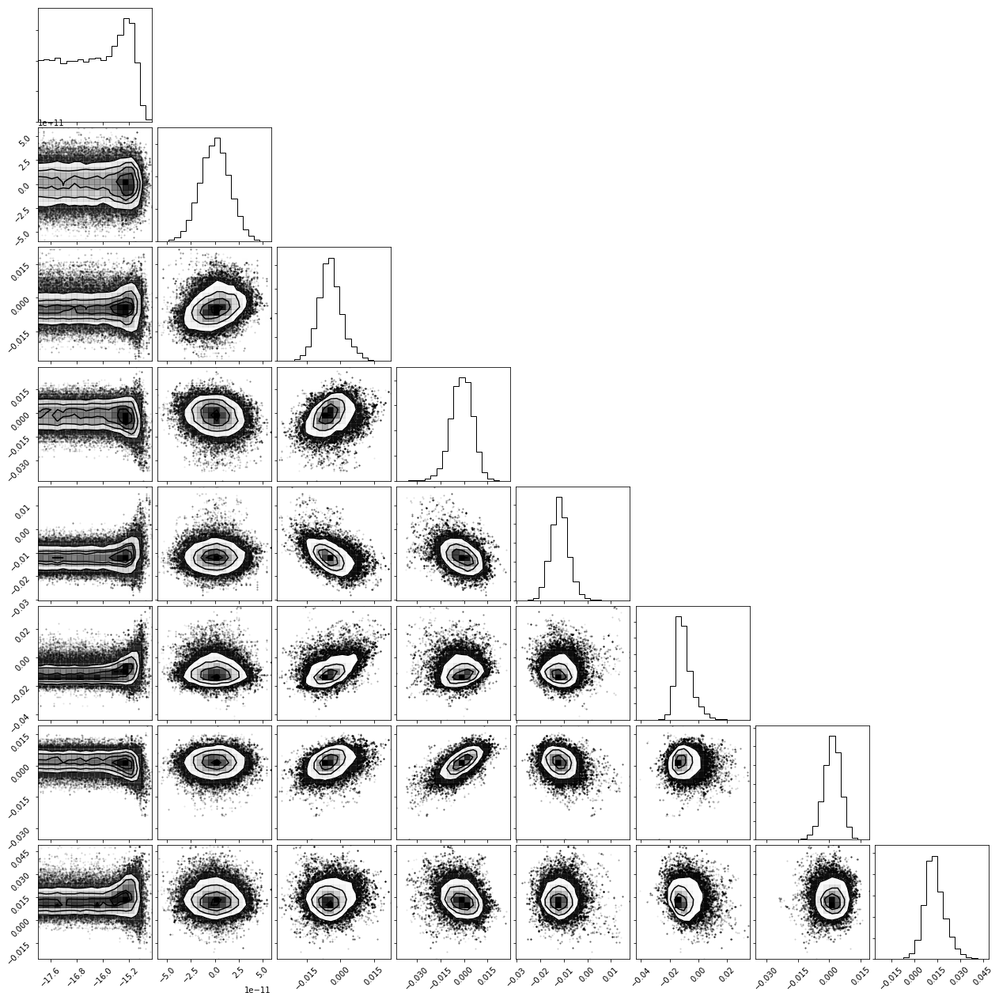

In [93]:
corner.corner(de436[:,[0,2,-6,-5,-4,-3,-2,-1]]);

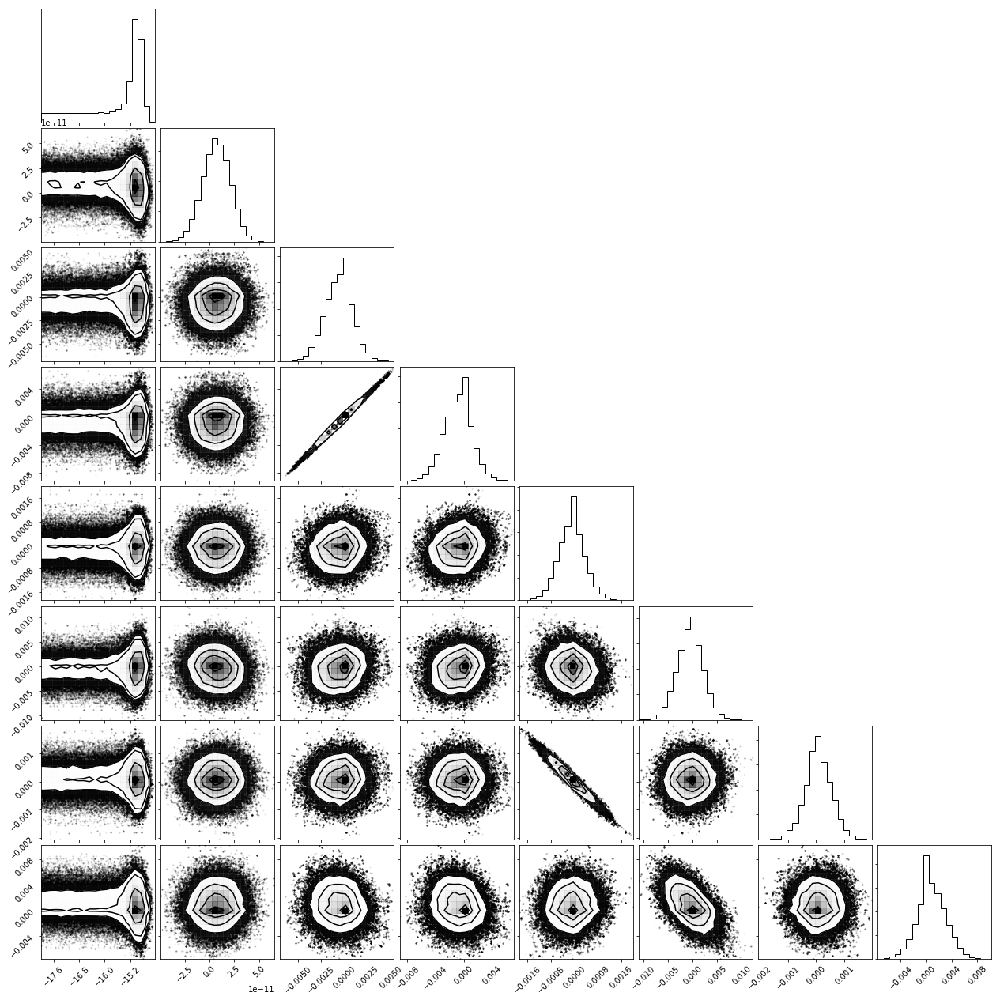

In [94]:
corner.corner(de435_pca[:,[0,2,-6,-5,-4,-3,-2,-1]]);

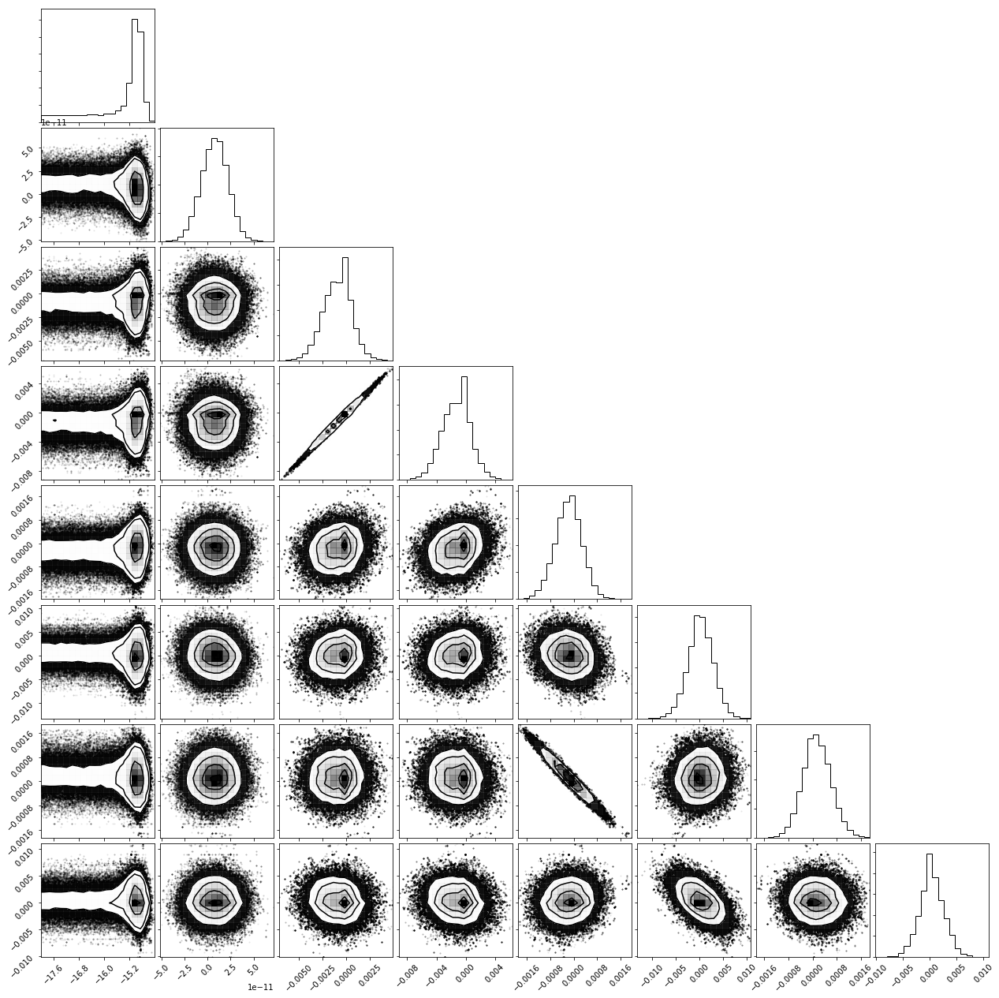

In [95]:
corner.corner(de436_pca[:,[0,2,-6,-5,-4,-3,-2,-1]]);

In [ ]:
for i in range(1000):
    d = 1e9*(perturb(pars[np.random.randint(pars.shape[0]),:],efit,disp=False) - eref)
    
    for j in range(3):
        pp.subplot(1,3,j+1)
        pp.plot(d[:,j],color='k',alpha=0.05)

In [163]:
l['a'].shape

(328100, 84)

In [165]:
??loadpars

## 11-yr open-prior runs

In [130]:
pars = loadpars(datadir='michele_epphysmodel_nosat_nano11yr_chains', eph='DE435')

In [131]:
pars.shape

(170300, 11)

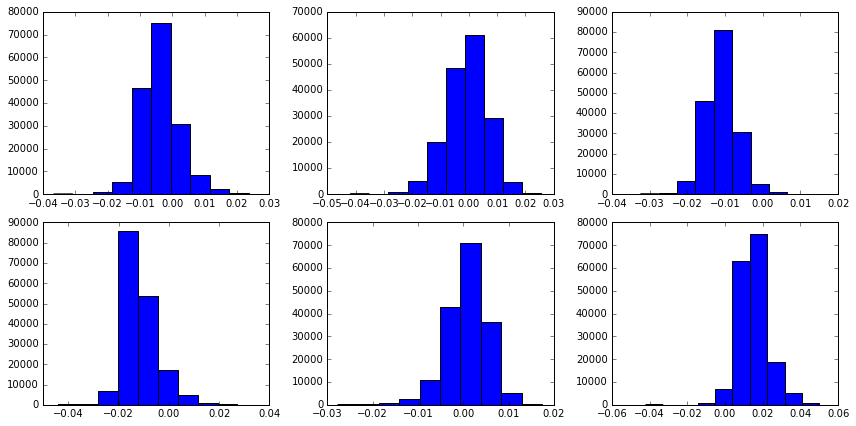

In [132]:
pp.figure(figsize=(12,6))

for i in range(5,11):
    pp.subplot(2,3,i-5+1)
    pp.hist(pars[:,i])
    
pp.tight_layout()

In [133]:
def detz():
    db = pars[np.random.randint(pars.shape[0]),-6:]
    
    return np.einsum('i,ijk->jk',db,jupiter_svd)

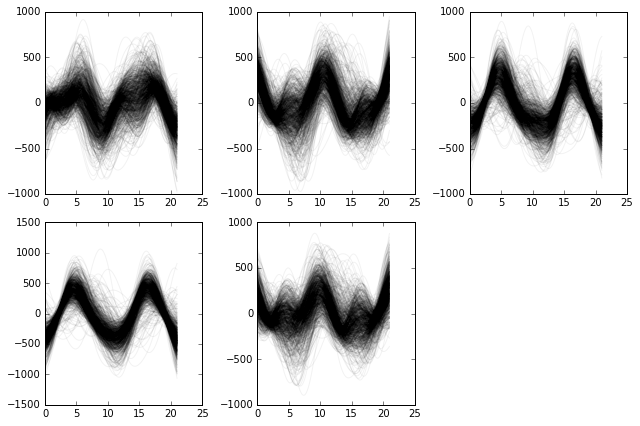

In [135]:
pp.figure(figsize=(9,6))

for i in range(1000):
    dz = detz() / 1e3

    for i in range(5):
        r = project(dates, 1e9*np.dot(dz,psrlist[i]))
        
        pp.subplot(2,3,i+1)
        pp.plot((dates - dates[0])/365.25, r, 'k', alpha=0.05) # ns

pp.tight_layout()

In [136]:
efit = getplanet('de435t.bsp',10,jdates)
eref = getplanet('de436t.bsp',10,jdates)

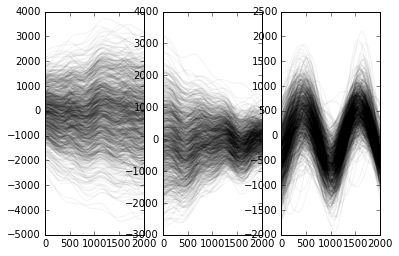

In [151]:
for i in range(1000):
    d = 1e9*(perturb(pars[np.random.randint(pars.shape[0]),:],efit,disp=False) - eref)
    
    for j in range(3):
        pp.subplot(1,3,j+1)
        pp.plot(d[:,j],color='k',alpha=0.05)